# Generic Unet for Fiji 

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from scipy.optimize import curve_fit
import skimage
from PIL import Image
import random
import utils
import shutil
import os

In [2]:
data='/home/ubuntu/Data/'

In [3]:
base_scaler=32

# Get data

Load data from file

In [4]:
both=skimage.external.tifffile.imread(data+'TrainingWindows.tif_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,1,2), 2,3)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-1

In [5]:
train_data=both[:,:,:,0:-1]/655350.0
train_truth=both[:,:,:,[-1]]

#non_zeros=np.where(train_data!=0)
mean=np.mean(train_data)
std=np.std(train_data)


train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1

validation=skimage.external.tifffile.imread(data+'Validation.tif')
validation=np.swapaxes(np.swapaxes(validation,1,2), 2,3)

validation_data=validation[:,:,:,0:-1]/655350.0
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,[-1]]
validation_truth[np.where(validation_truth>0.1)]=1


In [6]:
print([mean, std])

[0.35697535, 0.03371131]


# Design network

Define a function to create a convolutional layer, including conv, relu, maxpool, that can be called multiple times

In [7]:
tf.reset_default_graph()
#Input and output
x=tf.placeholder(dtype=tf.float32, shape=[None, x_dim,y_dim,channels], name='x')
y=tf.placeholder(dtype=tf.float32, shape=[None, x_dim,y_dim,1], name='y')
lr=tf.placeholder(dtype=tf.float32, shape=[], name='learning_rate')
dr=tf.placeholder(dtype=tf.float32, shape=[], name='dropout_rate')

xr=tf.identity(x)
yr=tf.identity(y)

#base_scaler=32

#Going down
A1=tf.keras.layers.Conv2D(base_scaler, 5, padding='SAME', activation=utils.leaky_relu)(xr)
A2=tf.keras.layers.Conv2D(base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(A1)

B0=tf.nn.max_pool(A2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
B1=tf.keras.layers.Conv2D(2*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(B0)
B2=tf.keras.layers.Conv2D(2*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(B1)

C0=tf.nn.max_pool(B2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
C1=tf.keras.layers.Conv2D(4*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(C0)
C2=tf.keras.layers.Conv2D(4*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(C1)

D0=tf.nn.max_pool(C2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
D1=tf.keras.layers.Conv2D(8*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(D0)
D2=tf.keras.layers.Conv2D(8*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(D1)

E0=tf.nn.max_pool(D2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
E1=tf.keras.layers.Conv2D(16*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(E0)
E2=tf.keras.layers.Conv2D(16*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(E1)

#Coming up
DD0=tf.keras.layers.Conv2DTranspose(8*base_scaler, kernel_size=3, strides=2, padding='SAME')(E2)
DD1=tf.concat(axis=3, values=[DD0,D2])
DD2=tf.keras.layers.Conv2D(8*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(DD1)
DD3=tf.keras.layers.Conv2D(8*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(DD2)

CC0=tf.keras.layers.Conv2DTranspose(4*base_scaler, kernel_size=3, strides=2, padding='SAME')(DD3)
CC1=tf.concat(axis=3, values=[CC0,C2])
CC2=tf.keras.layers.Conv2D(4*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(CC1)
CC3=tf.keras.layers.Conv2D(4*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(CC2)

BB0=tf.keras.layers.Conv2DTranspose(2*base_scaler, kernel_size=3, strides=2, padding='SAME')(CC3)
BB1=tf.concat(axis=3, values=[BB0,B2])
BB2=tf.keras.layers.Conv2D(2*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(BB1)
BB3=tf.keras.layers.Conv2D(2*base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(BB2)

AA0=tf.keras.layers.Conv2DTranspose(base_scaler, kernel_size=3, strides=2, padding='SAME')(BB3)
AA1=tf.concat(axis=3, values=[AA0,A2])
AA2=tf.keras.layers.Conv2D(base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(AA1)
AA3=tf.keras.layers.Conv2D(base_scaler, 3, padding='SAME', activation=utils.leaky_relu)(AA2)

logits=tf.keras.layers.Conv2D(1, 1, padding='SAME', activation=utils.leaky_relu)(AA3)
probs=tf.tanh(logits, name='probabilities')

diff=tf.subtract(probs, yr)
LSQ=tf.multiply(diff,diff)
#Added this to make the outlines more potent in error function
#OutError, MaskError=tf.split(LSQ, [1,1], 3)
#loss=1*tf.reduce_mean(OutError)+0.1*tf.reduce_mean(MaskError)
loss=tf.reduce_mean(LSQ, name='error')
l2_loss = tf.losses.get_regularization_loss()
#loss=loss+l2_loss/1000

train_op=tf.train.AdamOptimizer(learning_rate=lr, name='trainer').minimize(loss)

tf.summary.scalar('loss', loss)
tf.summary.image('input', tf.reshape(x[:,:,:,0], [-1, x_dim, y_dim,1]), 3)
tf.summary.image('standard', tf.reshape(y[:,:,:,0], [-1, x_dim, y_dim,1]) , 3)
tf.summary.image('outline', tf.reshape(probs[:,:,:,0], [-1, x_dim, y_dim,1]), 3)



merge = tf.summary.merge_all()

Instructions for updating:
Colocations handled automatically by placer.


# Training

0
Training loss:  0.09942733
(3, 512, 512, 1)
Validation loss:  0.1439959


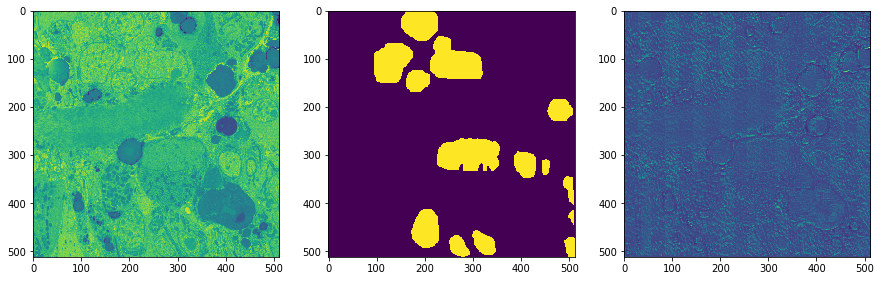

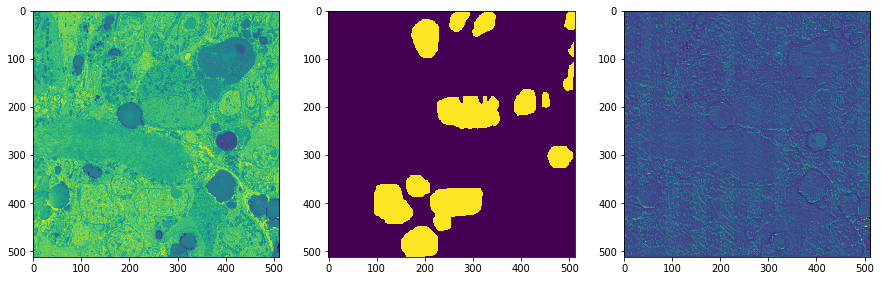

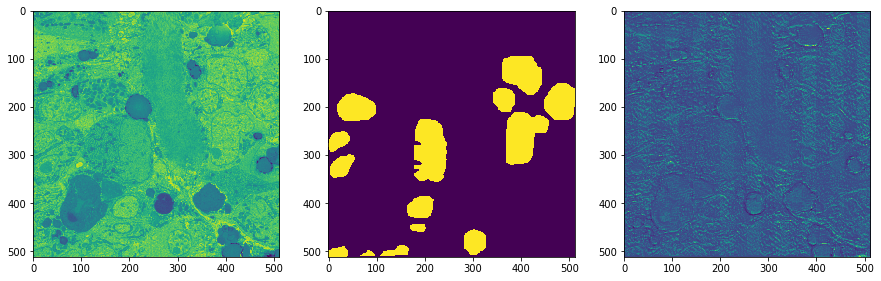

100
Training loss:  0.07313629
(3, 512, 512, 1)
Validation loss:  0.098119855


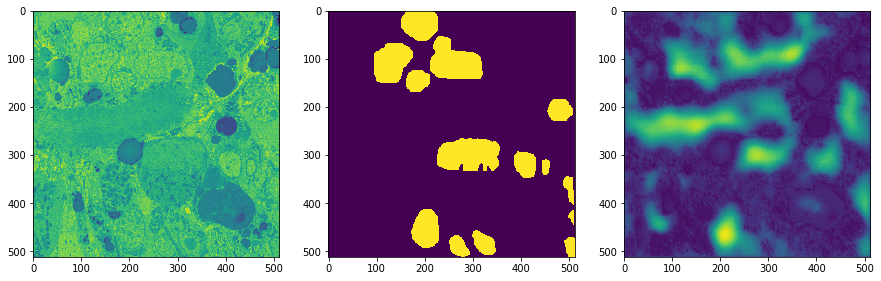

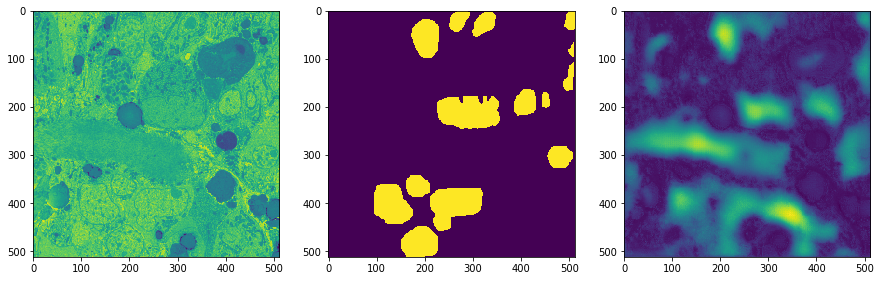

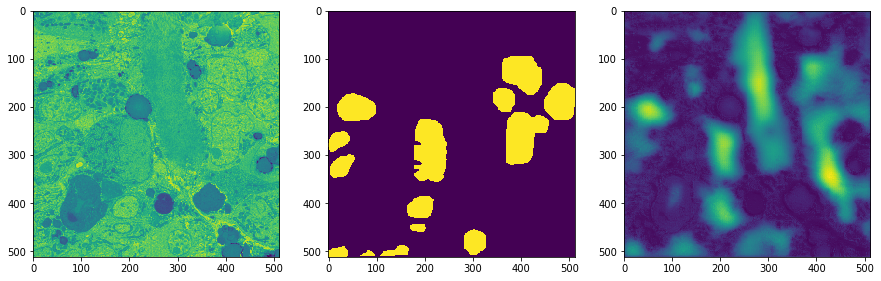

200
Training loss:  0.051632278
(3, 512, 512, 1)
Validation loss:  0.08228963


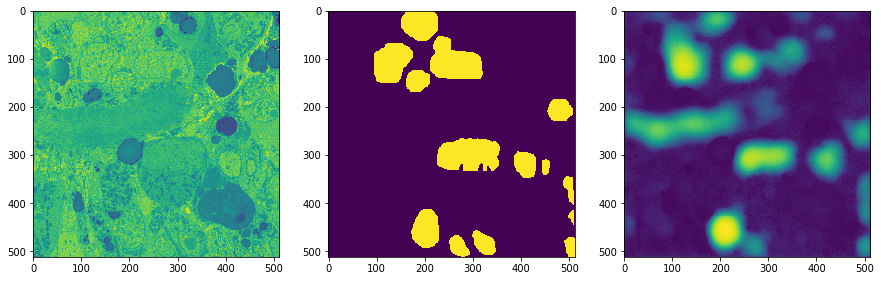

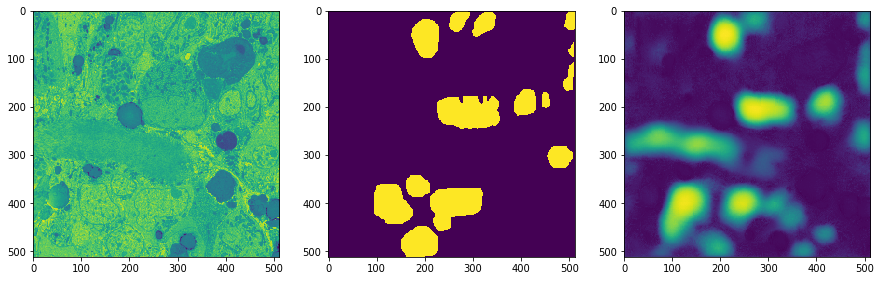

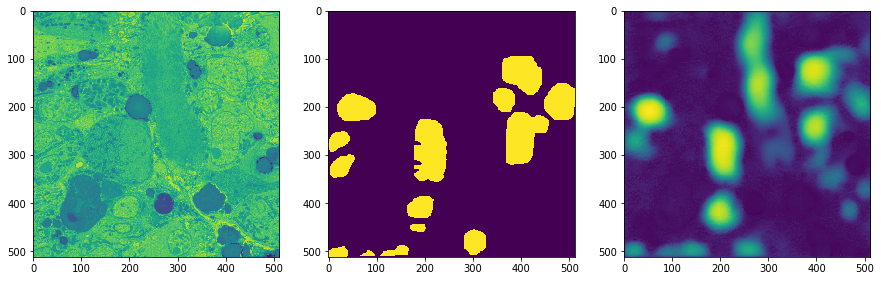

300
Training loss:  0.043444548
(3, 512, 512, 1)
Validation loss:  0.06463047


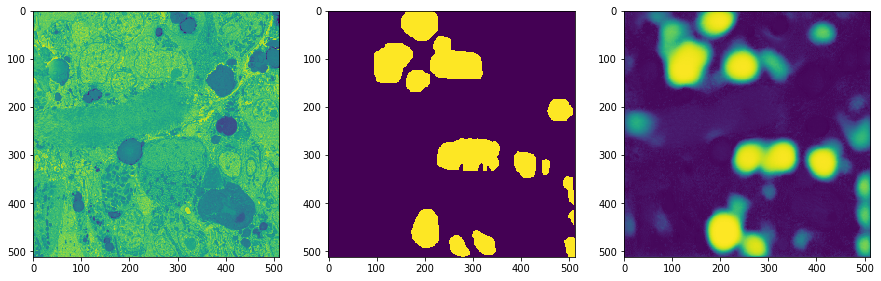

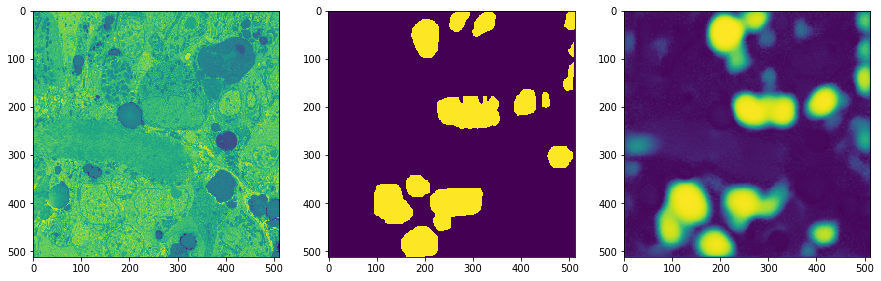

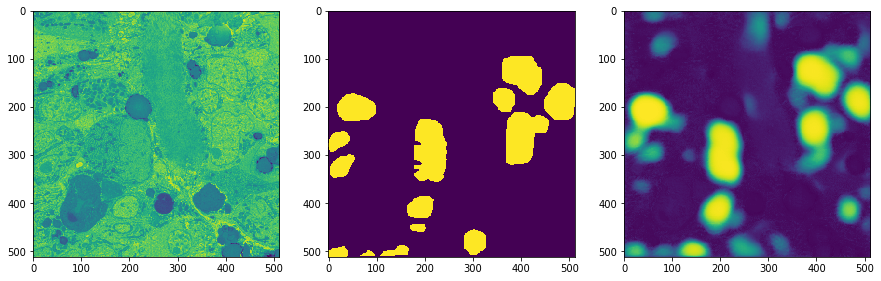

400
Training loss:  0.023713326
(3, 512, 512, 1)
Validation loss:  0.03267245


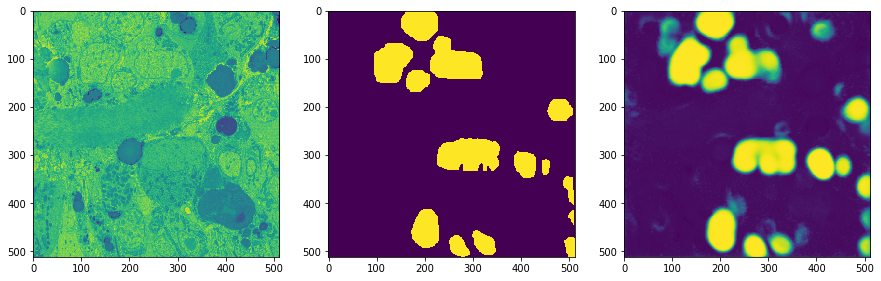

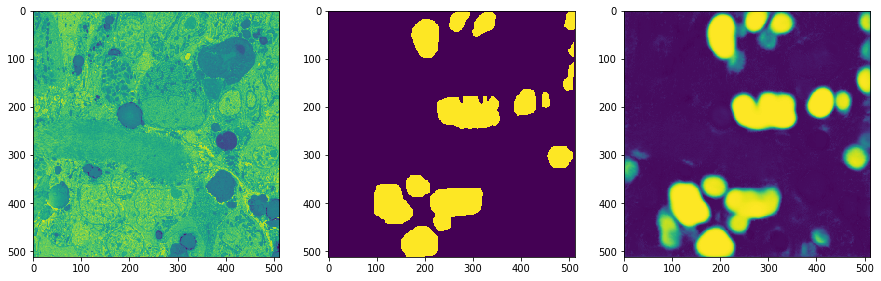

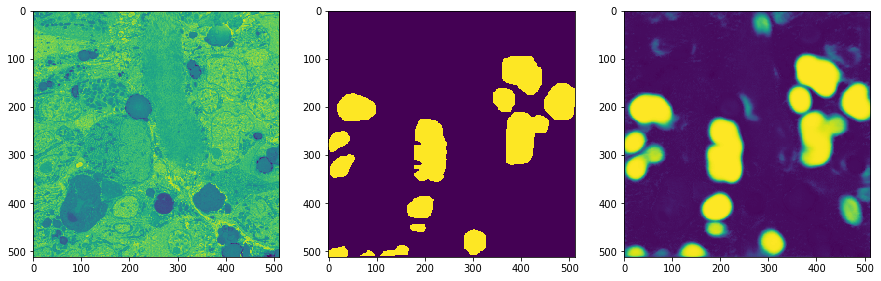

500
Training loss:  0.015513147
(3, 512, 512, 1)
Validation loss:  0.03049322


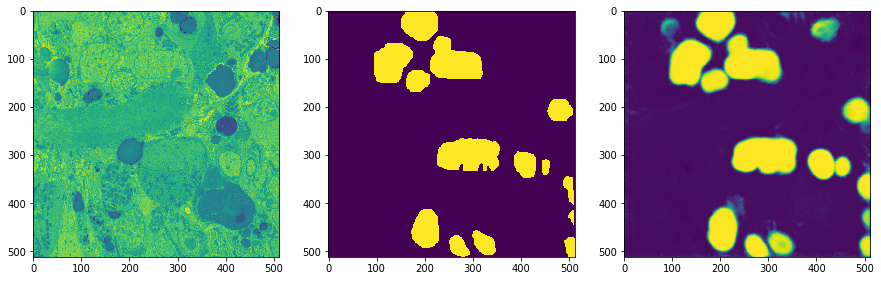

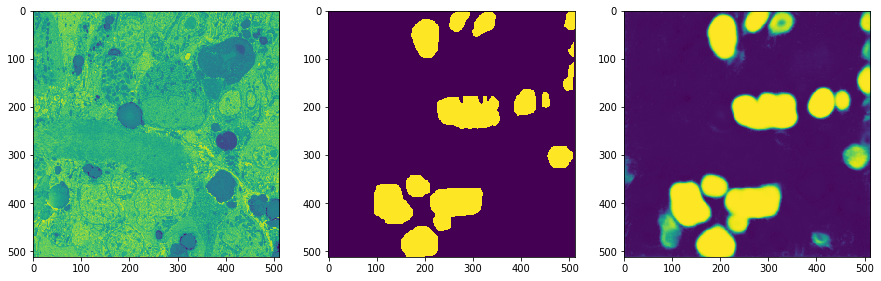

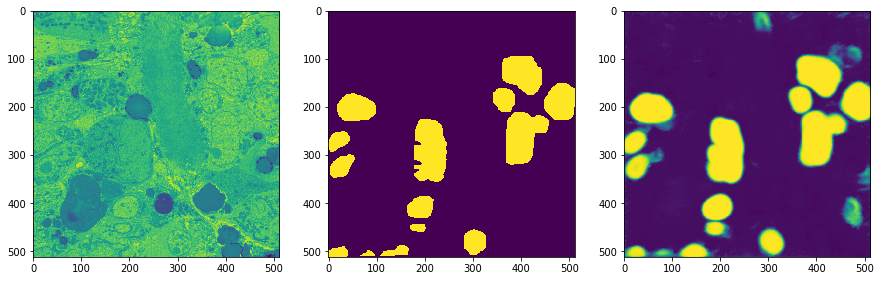

600
Training loss:  0.017118381
(3, 512, 512, 1)
Validation loss:  0.02484087


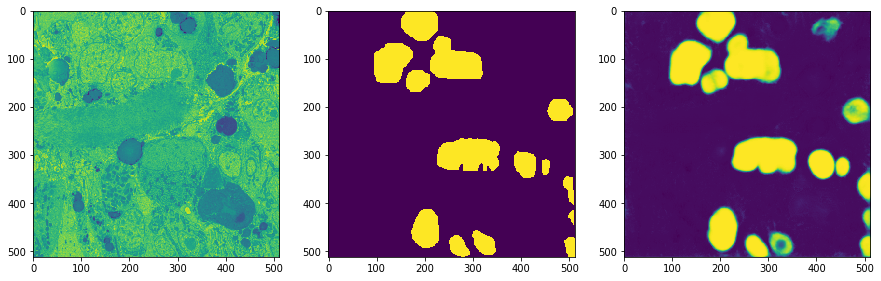

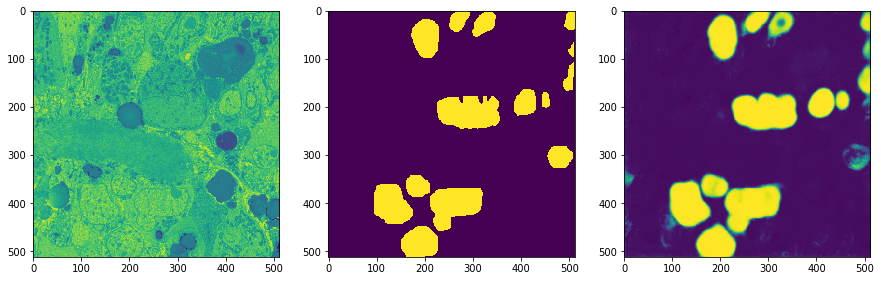

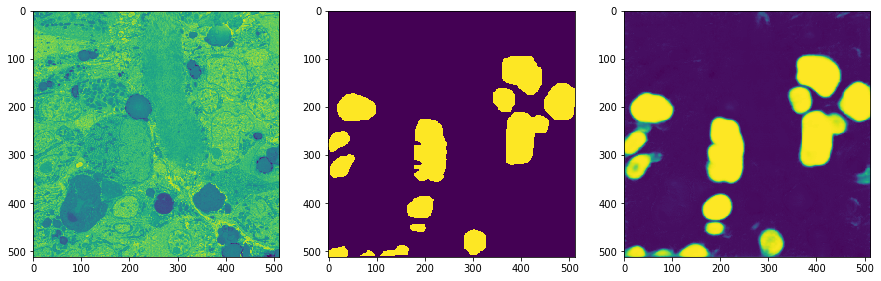

700
Training loss:  0.011605346
(3, 512, 512, 1)
Validation loss:  0.020637928


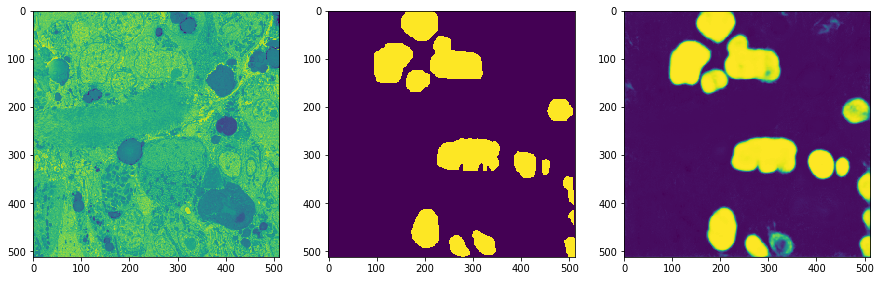

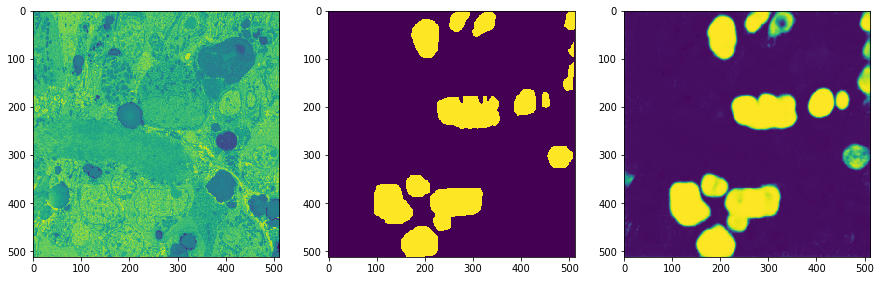

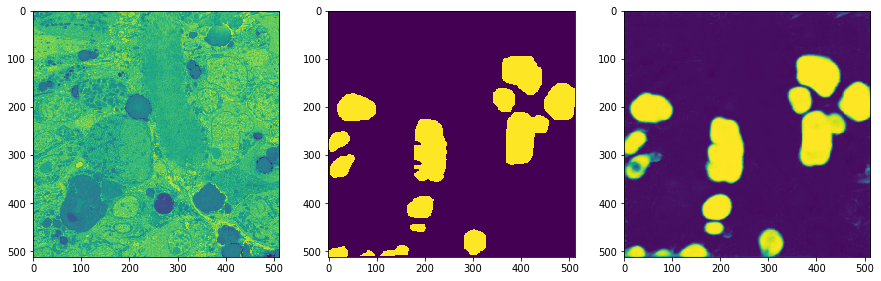

800
Training loss:  0.010397309
(3, 512, 512, 1)
Validation loss:  0.022653684


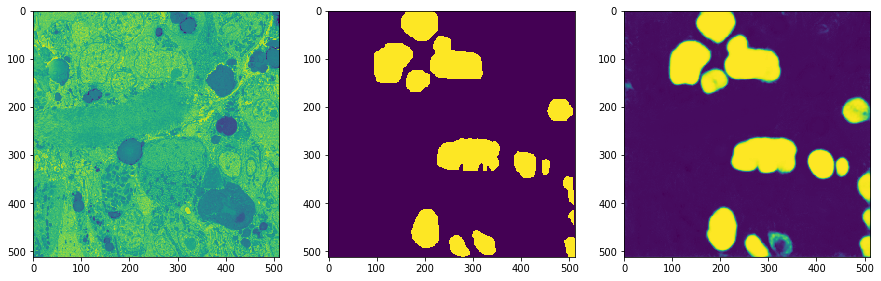

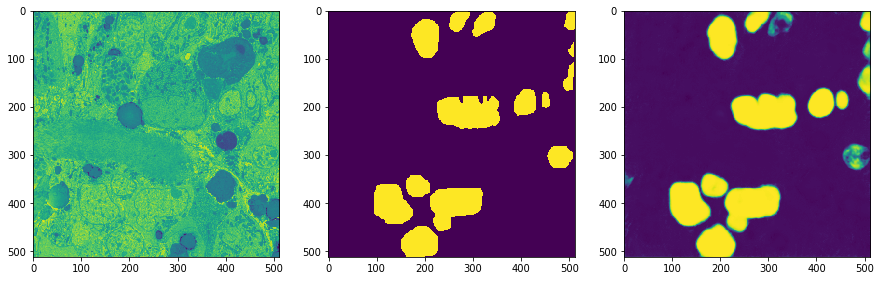

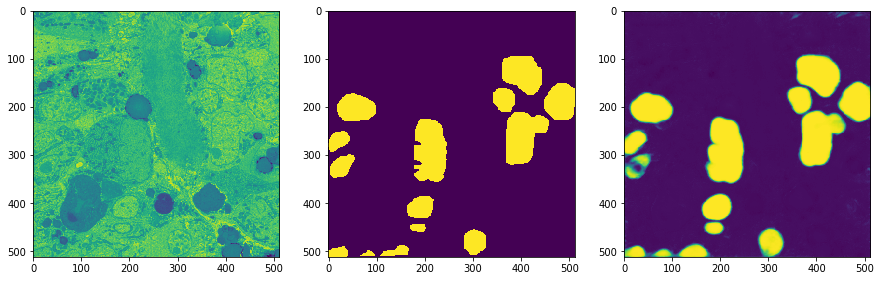

900
Training loss:  0.007953962
(3, 512, 512, 1)
Validation loss:  0.024874695


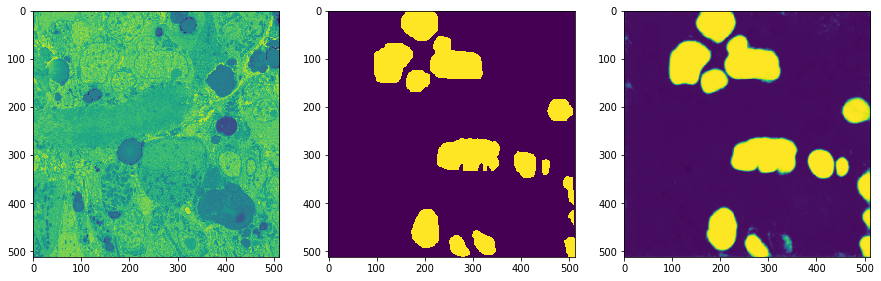

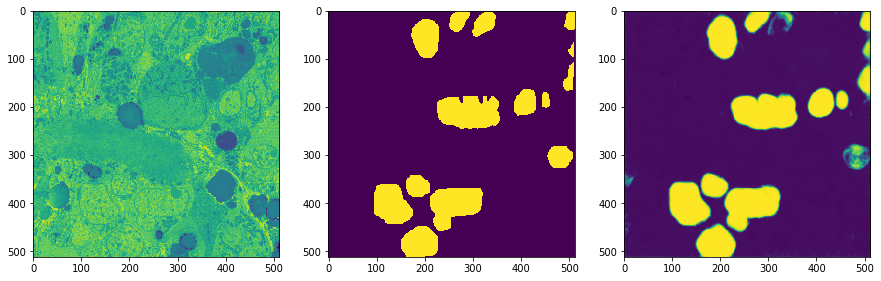

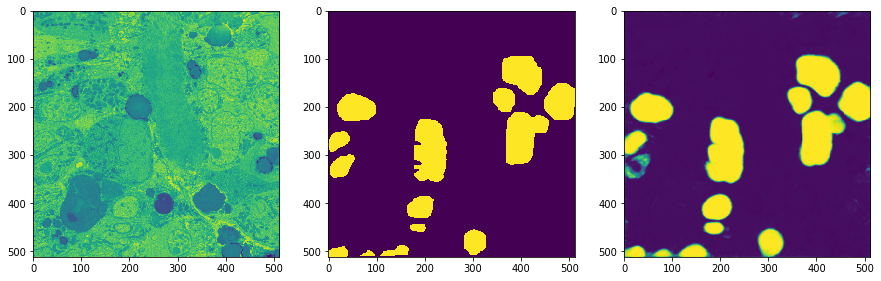

1000
Training loss:  0.010120187
(3, 512, 512, 1)
Validation loss:  0.02362509


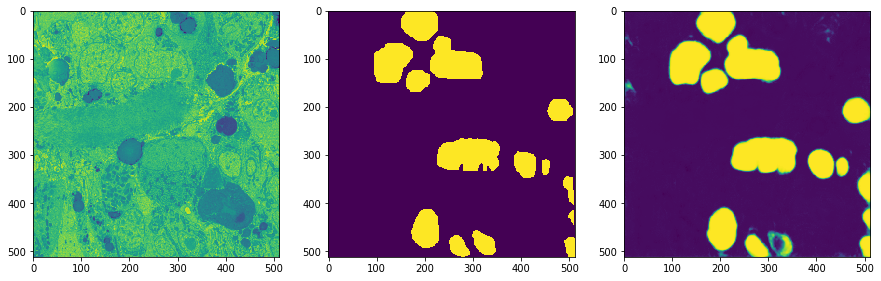

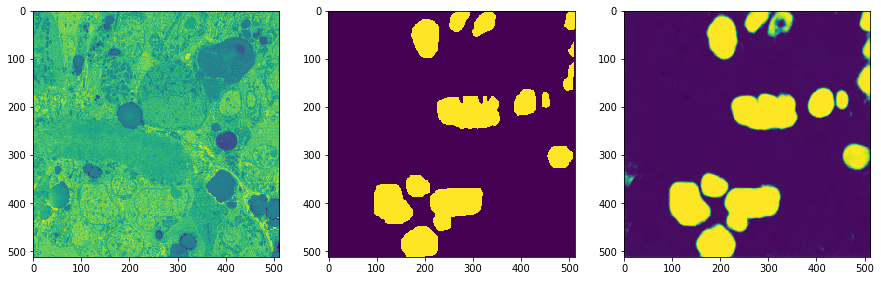

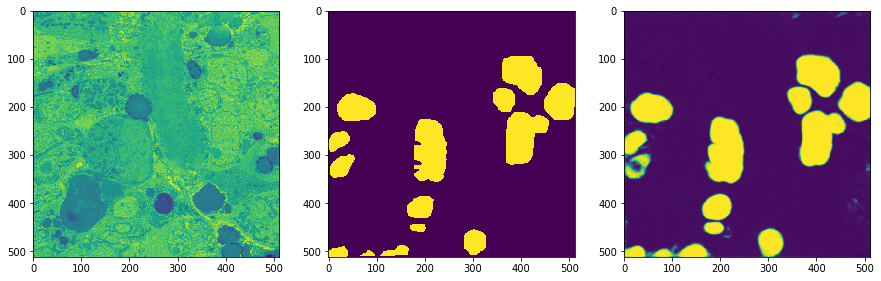

1100
Training loss:  0.0109564625
(3, 512, 512, 1)
Validation loss:  0.020634793


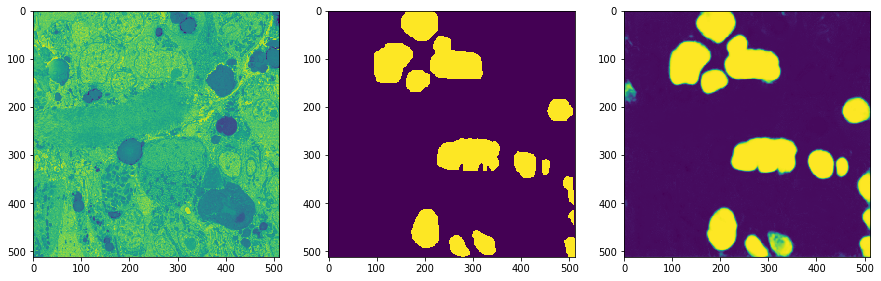

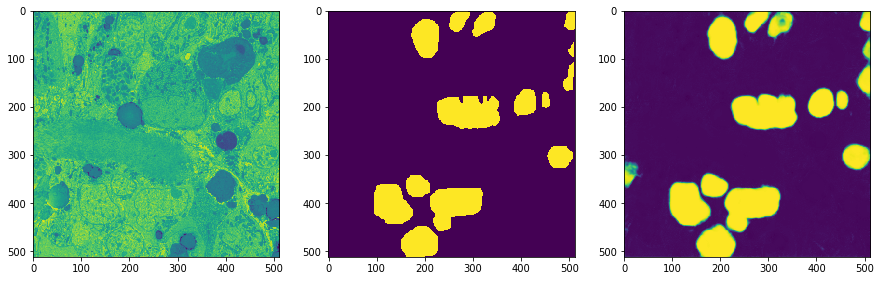

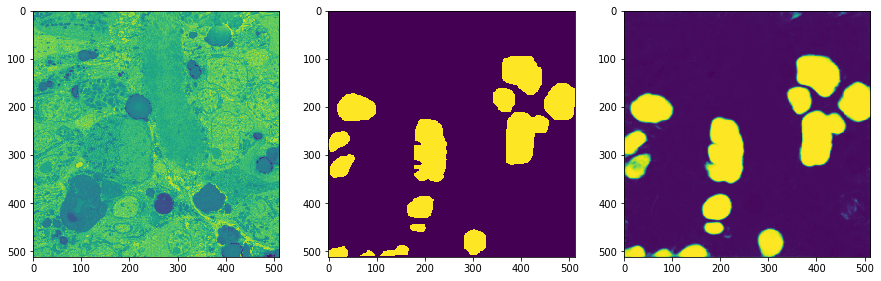

1200
Training loss:  0.008680236
(3, 512, 512, 1)
Validation loss:  0.022577


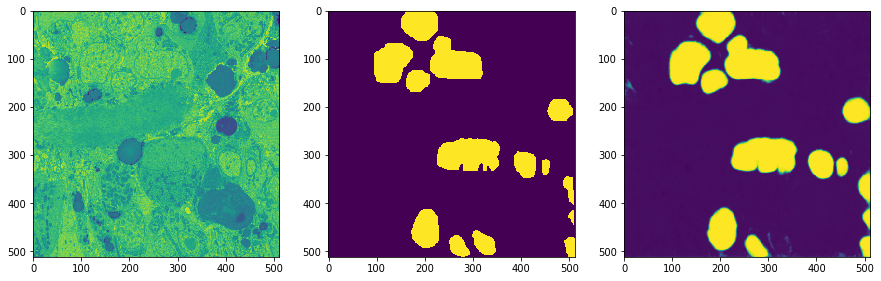

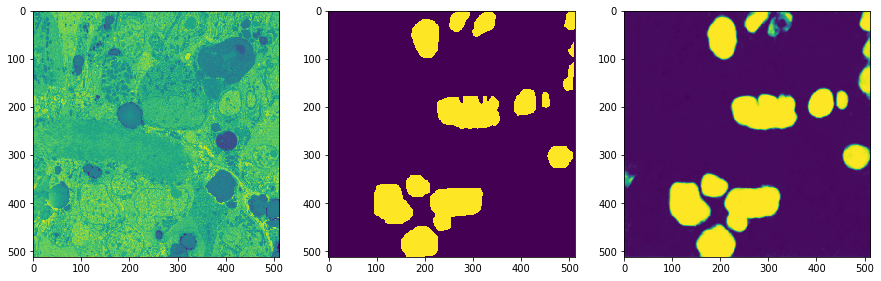

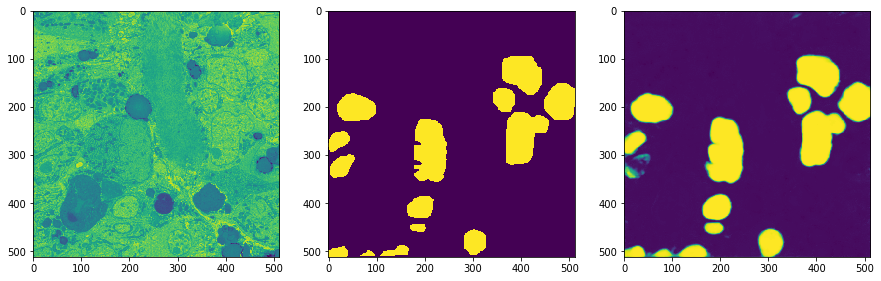

1300
Training loss:  0.008675024
(3, 512, 512, 1)
Validation loss:  0.023912033


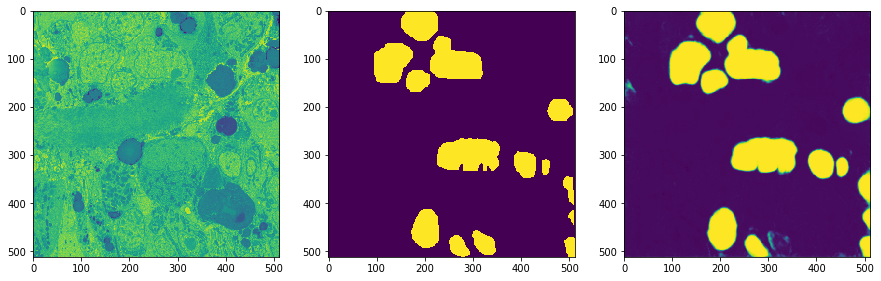

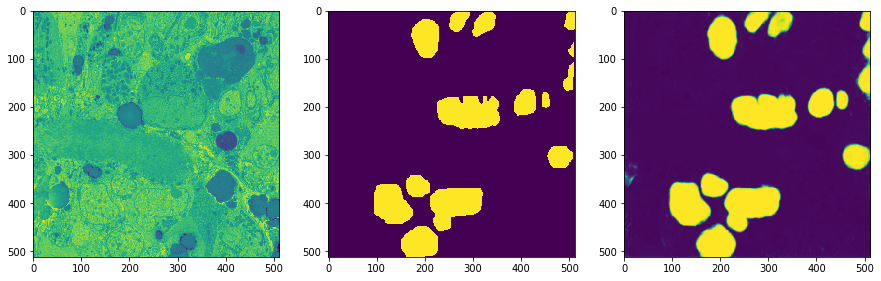

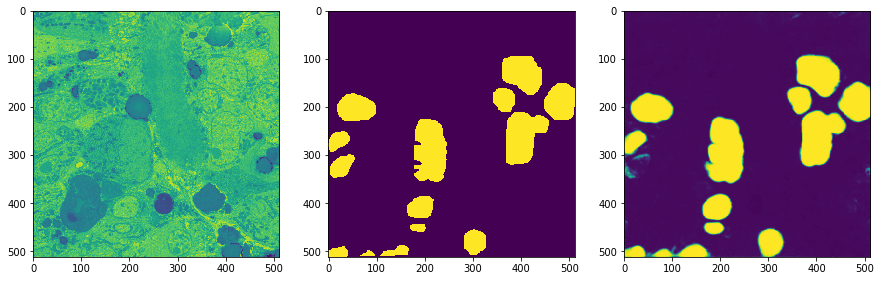

1400
Training loss:  0.006145664
(3, 512, 512, 1)
Validation loss:  0.019497437


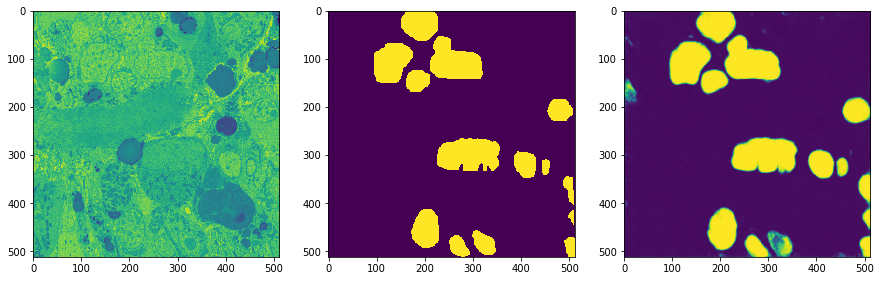

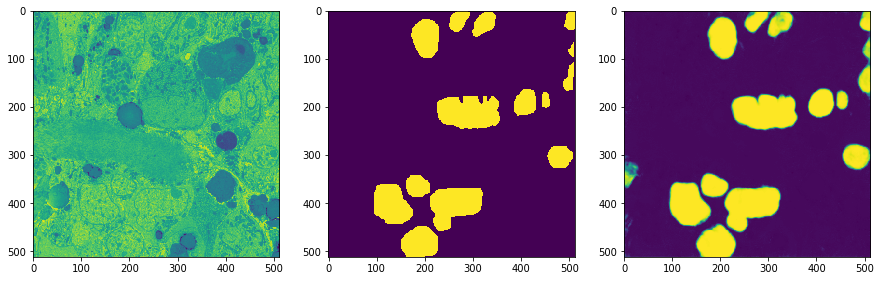

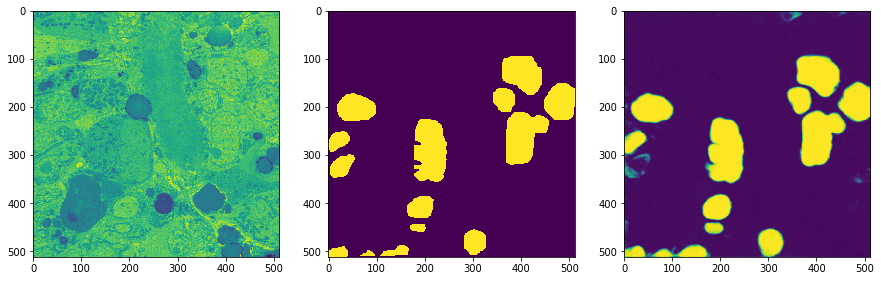

1500
Training loss:  0.00693317
(3, 512, 512, 1)
Validation loss:  0.023102663


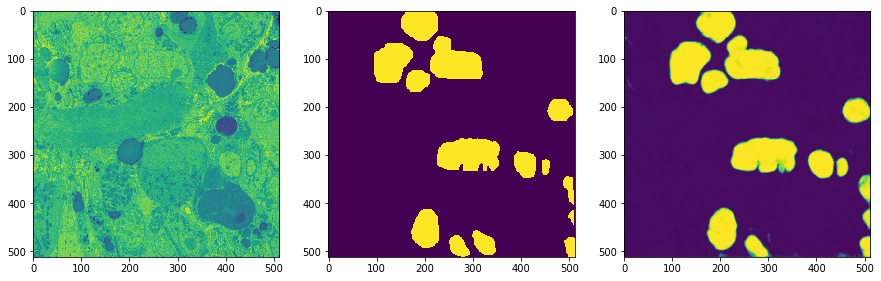

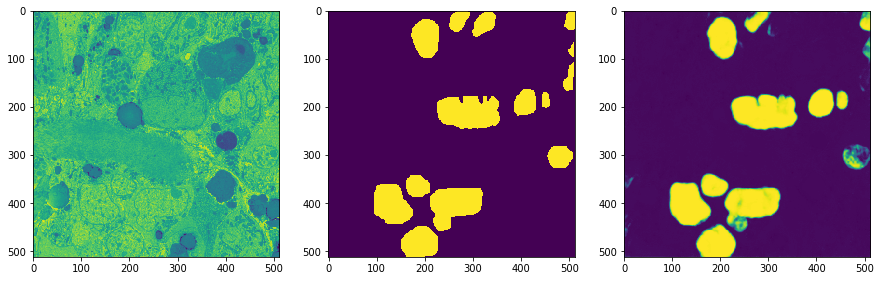

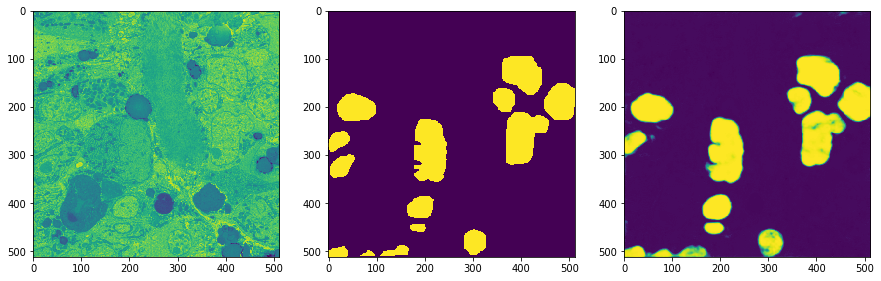

1600
Training loss:  0.0063580144
(3, 512, 512, 1)
Validation loss:  0.024723321


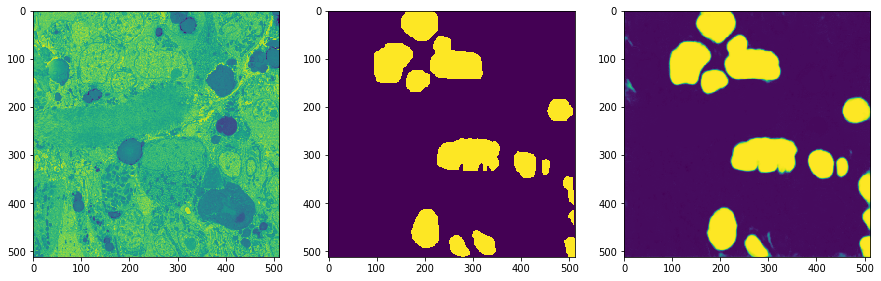

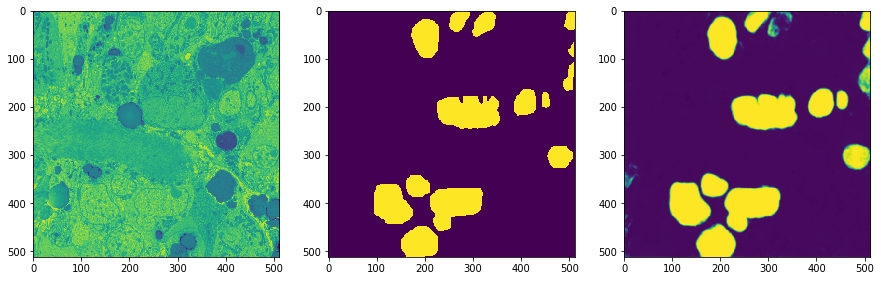

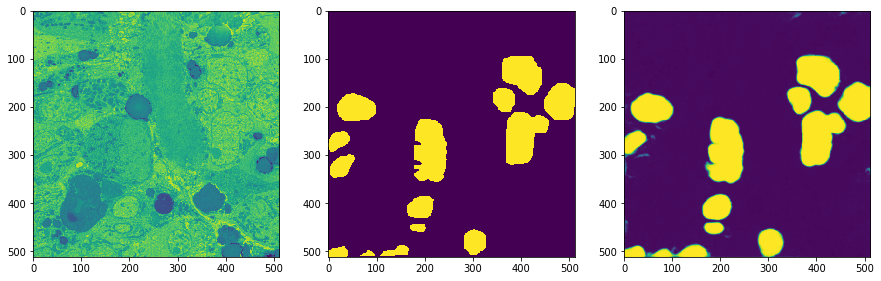

1700
Training loss:  0.005567246
(3, 512, 512, 1)
Validation loss:  0.024566522


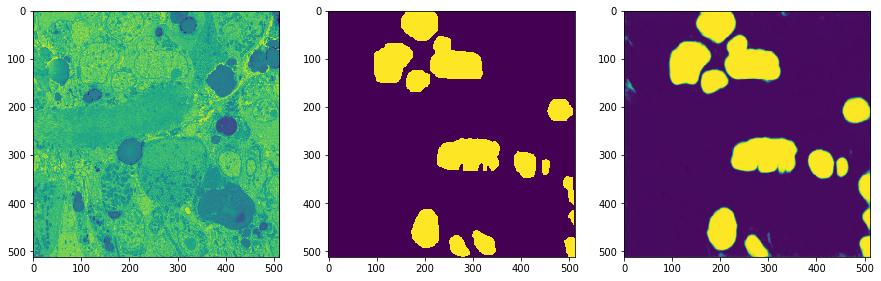

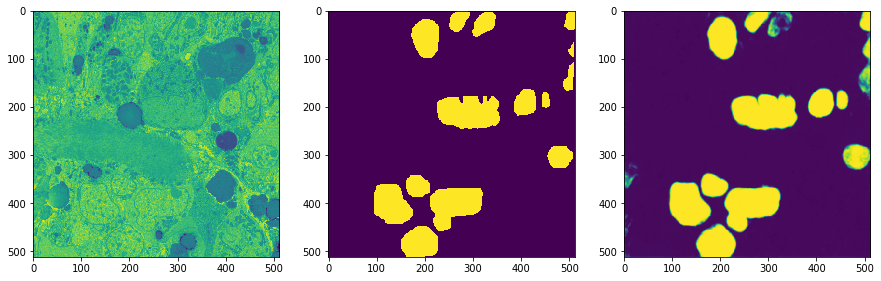

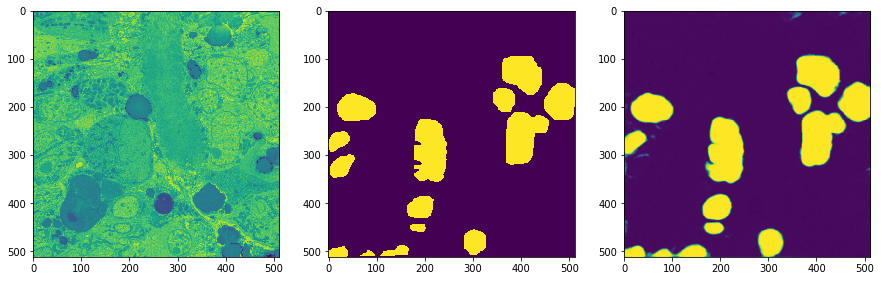

1800
Training loss:  0.0065962123
(3, 512, 512, 1)
Validation loss:  0.02531989


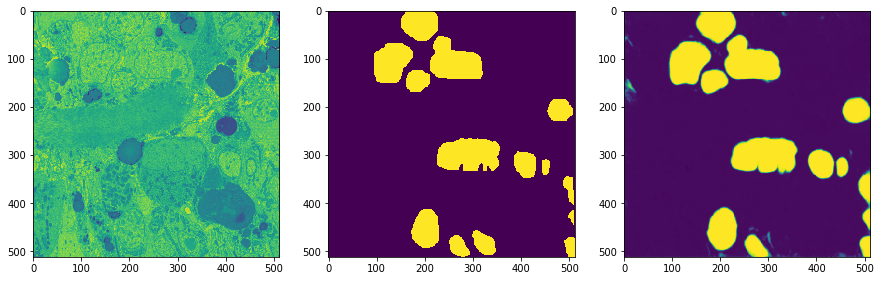

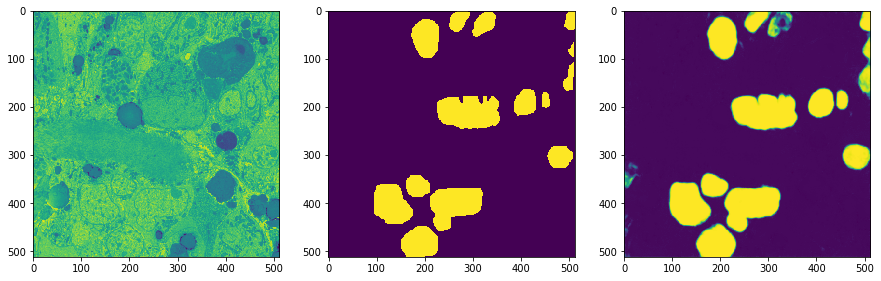

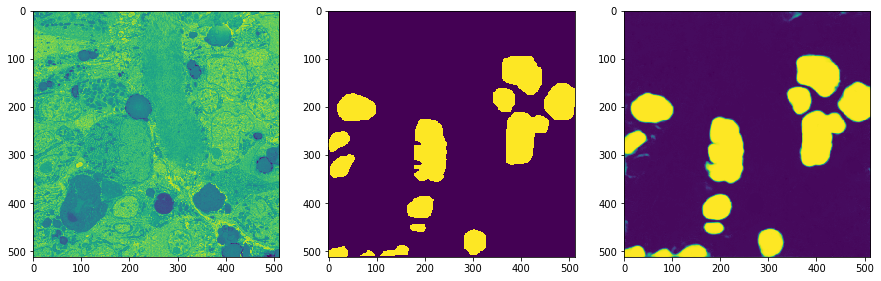

1900
Training loss:  0.004906141
(3, 512, 512, 1)
Validation loss:  0.024969405


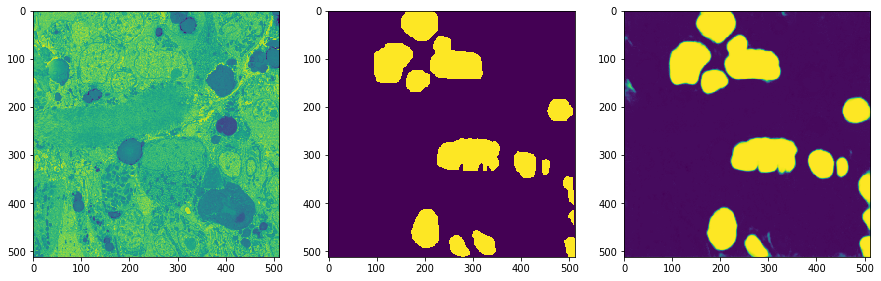

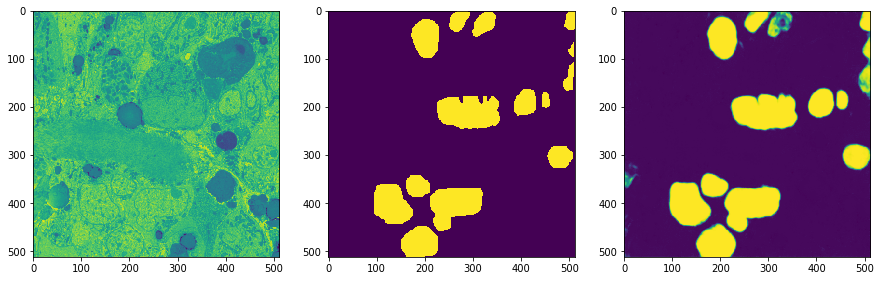

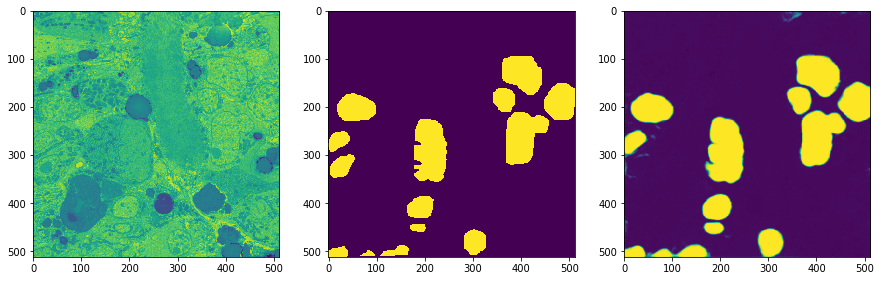

2000
Training loss:  0.0060402155
(3, 512, 512, 1)
Validation loss:  0.02588859


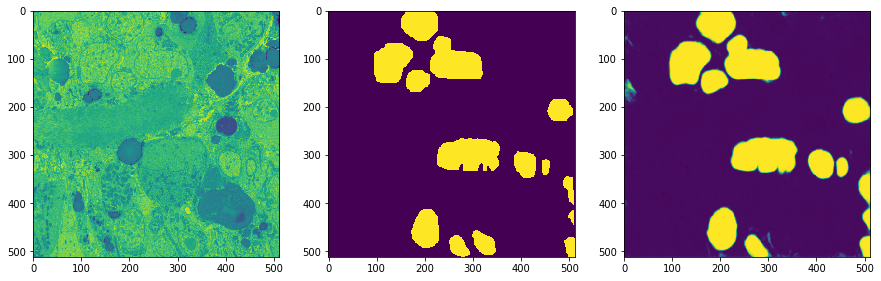

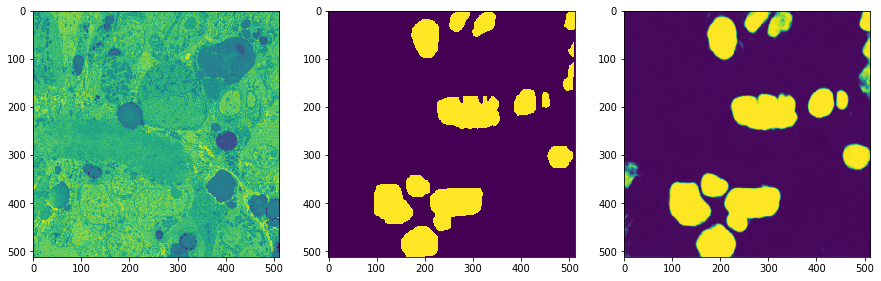

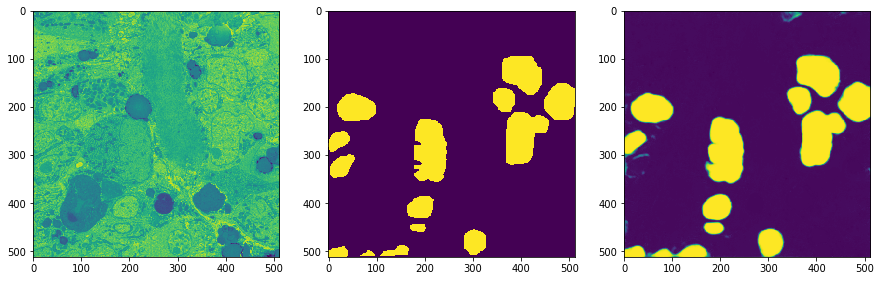

2100
Training loss:  0.0058215526
(3, 512, 512, 1)
Validation loss:  0.02412536


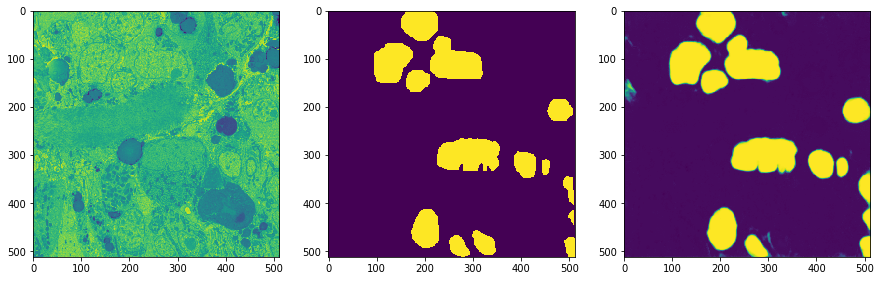

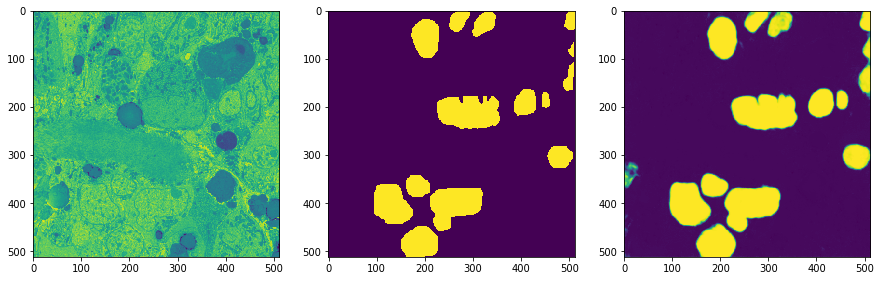

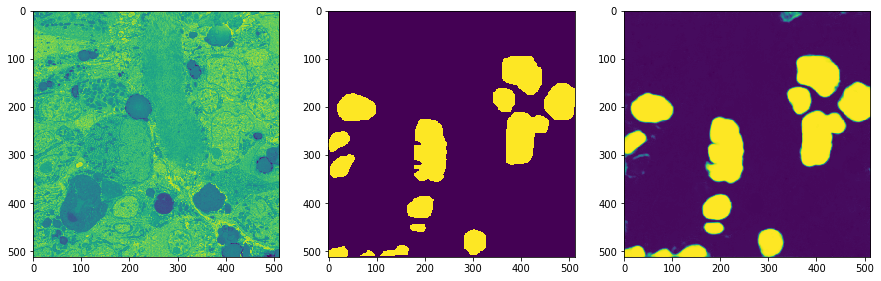

In [8]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
sess=tf.Session()
sess.run(tf.global_variables_initializer())
saver = tf.train.Saver(max_to_keep=50)
#train_writer = tf.summary.FileWriter('./logs/1/train ', sess.graph)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.000195, 0.0001, 0.00002, 0.00001]
learning_rate_steps=[500,1500, 2200, 2200]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[15])
        cur_train=train_data[idx,:,:,:]+np.random.uniform(-0.3, 0.3, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,:,:,0], sub_validation_truth[ti,:,:,0], results[ti,:,:,0])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs

In [21]:
tf.train.write_graph(sess.graph_def, 'Data/NewModels/', 'saved_3100.pb', as_text=False)

'Data/NewModels/saved_3100.pb'

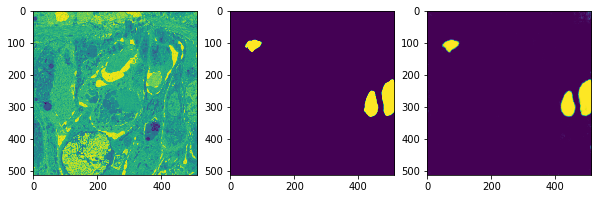

In [31]:
idx=np.random.choice(validation_data.shape[0], replace=False, size=[25])
cur_train=train_data[idx,:,:,:]
cur_truth=train_truth[idx,:,:]
results, losses=sess.run([probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})

ids=4
utils.plot_3x1(cur_train[ids,:,:,0], cur_truth[ids,:,:,0], results[ids,:,:,0])

# Process new datafiles using trained network

Load the network that works best

In [58]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
x_dim=int(file.readline())
mean=float(file.readline())
std=float(file.readline())
model=int(file.readline())
channels=int(file.readline())
file.close()

In [59]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

data_model=data+'NewModels/Model'+str(model)
saver.restore(sess,data_model)

Function for processing a file

In [60]:
def process_file(sess, file_path, save_dir):
    file_data=skimage.external.tifffile.imread(file_path)
    if (len(file_data.shape)==3):
        file_data=np.reshape(file_data, [file_data.shape[0], x_dim, x_dim, 1])
    else:
        file_data=np.swapaxes(np.swapaxes(file_data,1,2), 2,3)
    inference_data=file_data/655350.0
    
    #true_test2_data=true_test2_data/np.std(true_test2_data)*0.02
    #true_test2_data=true_test2_data-np.mean(true_test2_data)+0.55
    #v1true_test2_data=(true_test2_data-.578)/.138+0.5
    inference_data=(inference_data-mean)/std+0.5

    channels=inference_data.shape[3]
    num_images=inference_data.shape[0]
    output=np.zeros([num_images,x_dim,x_dim,channels+2])
    process_batch_size=20
    print('Starting')
    for t in range(0,num_images,process_batch_size):
        endrng=np.min((t+process_batch_size,num_images))
        inference_batch_data=inference_data[t:(t+process_batch_size), :,:,:]
        results=sess.run(probs, feed_dict={x:inference_batch_data})
        output[t:(t+process_batch_size),:,:,0:channels]=inference_batch_data[:,:,:,0:channels]
        output[t:(t+process_batch_size),:,:,channels]=results[:,:,:,0]
        output[t:(t+process_batch_size),:,:,channels+1]=results[:,:,:,1]
    print('Done')
    inference_data=0
    output[:,:,:,0:channels]=file_data[:,:,:,0:channels]
    output=np.swapaxes(np.swapaxes(output,3,2),2,1)
    np.place(output, output<0, 0)
    file_name=file_path.split('/')[-1]
    print(output.dtype)
    skimage.external.tifffile.imsave(save_dir+file_name, output.astype('float32'), imagej=True)
    print('Written')
    return output


In [61]:
import glob
for f in glob.glob(data+'Data_input/*'):
    output=process_file(sess, f, data+'Data_output/')

Starting
Done
float64
Written


# Retrain using new data and best old model

In [49]:
if os.path.isdir(data+'NewModels/'):
    os.rename(data+'NewModels/', data+'OldModels/')

In [50]:
both=skimage.external.tifffile.imread(data+'Training_retrain_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,1,2), 2,3)

x_dim=both.shape[1]
y_dim=both.shape[2]
channels=both.shape[3]-2

In [51]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
x_dim=int(file.readline())
mean=float(file.readline())
std=float(file.readline())
model=int(file.readline())
channels=int(file.readline())
file.close()

In [52]:
train_data=both[:,:,:,0:-2]/655350.0
train_truth=both[:,:,:,[-2,-1]]

train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1

validation=skimage.external.tifffile.imread(data+'Validation_annotated.tif')
validation=np.swapaxes(np.swapaxes(validation,1,2), 2,3)

validation_data=validation[:,:,:,0:-2]/655350.0
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,[-2,-1]]
validation_truth[np.where(validation_truth>0.1)]=1


In [56]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

#data_model=data+'OldModels/Model'+str(model)
data_model=data+'OldModels/Model'+str(1500)
saver.restore(sess,data_model)

0
Training loss:  0.01055294
(3, 512, 512, 2)
Validation loss:  0.005736654


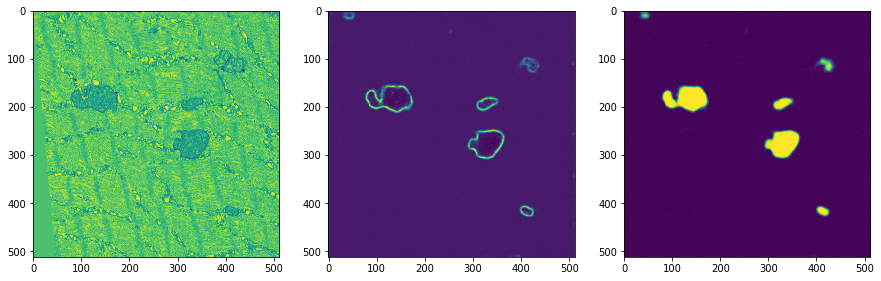

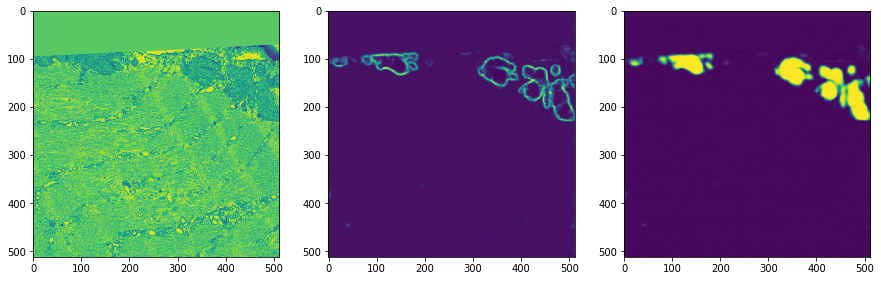

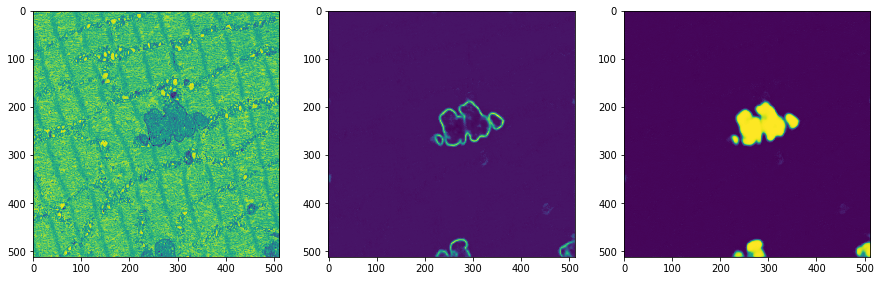

100
Training loss:  0.00900529
(3, 512, 512, 2)
Validation loss:  0.005215116


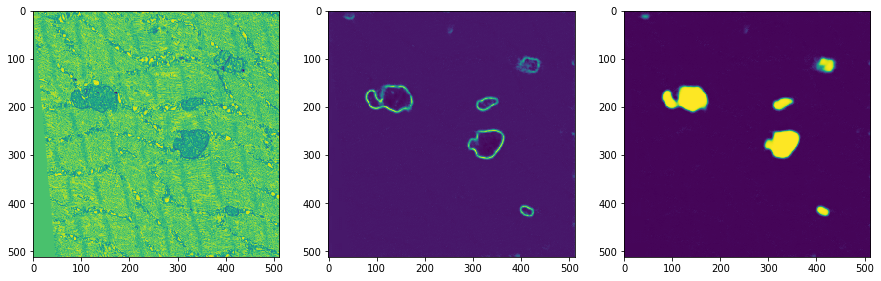

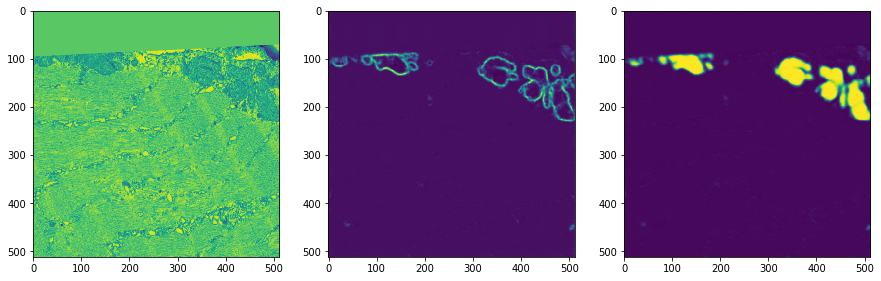

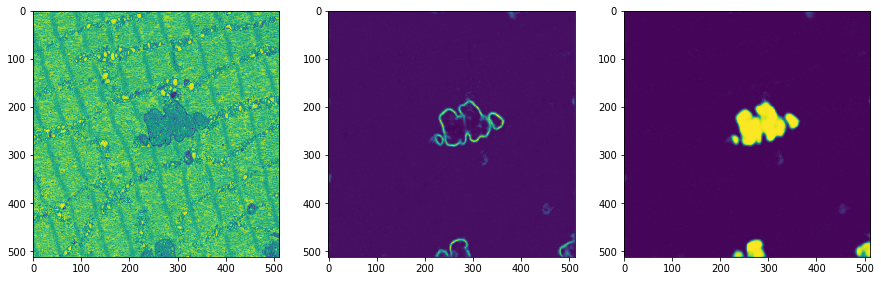

200
Training loss:  0.007782866
(3, 512, 512, 2)
Validation loss:  0.005301018


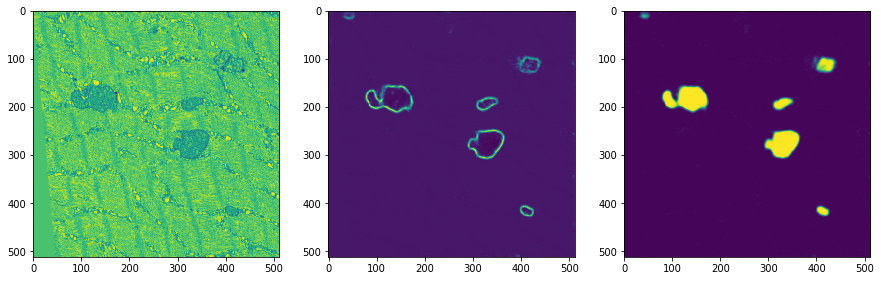

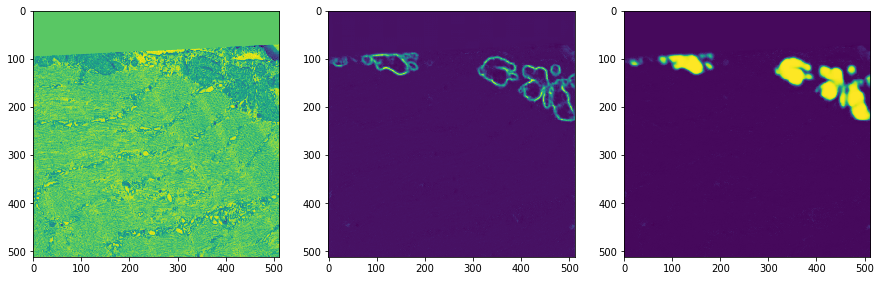

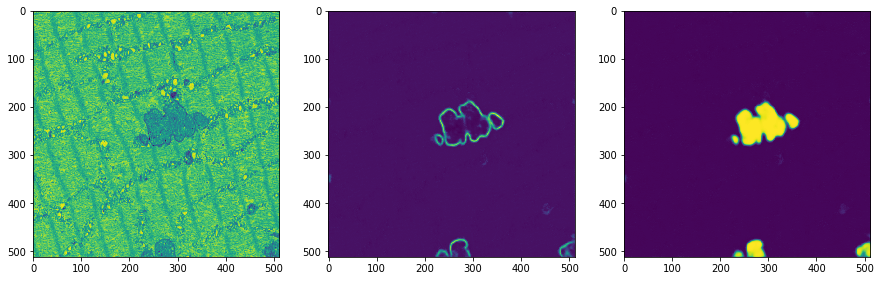

300
Training loss:  0.0063638096
(3, 512, 512, 2)
Validation loss:  0.005252032


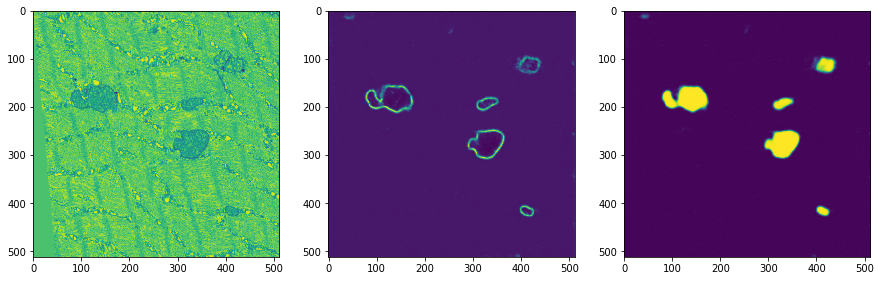

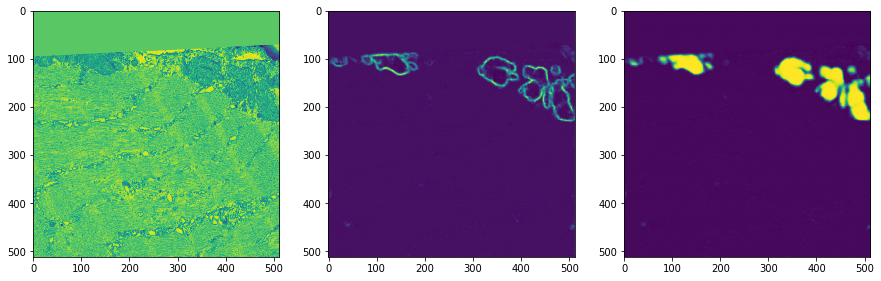

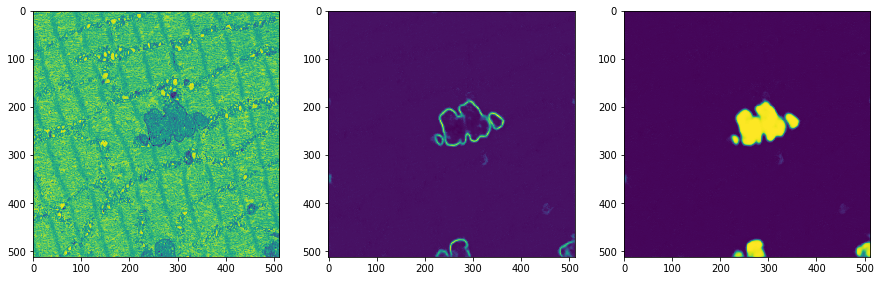

400
Training loss:  0.011437751
(3, 512, 512, 2)
Validation loss:  0.005232986


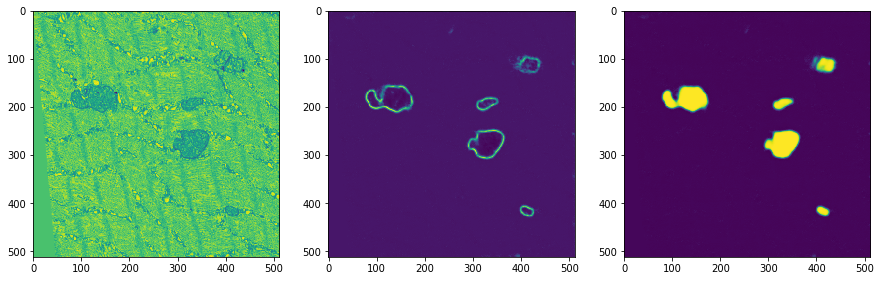

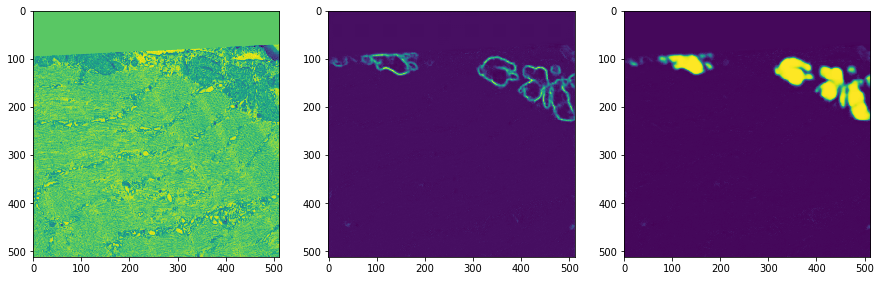

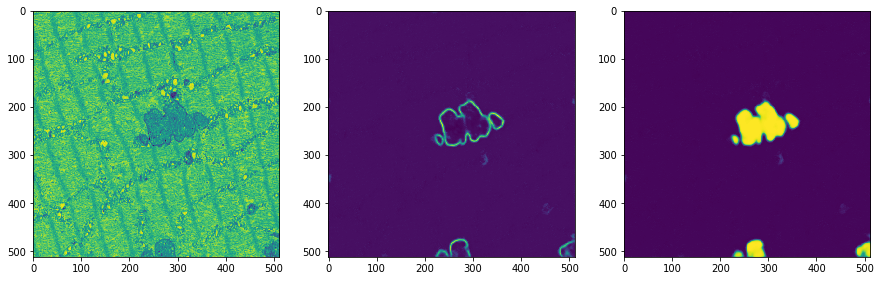

500
Training loss:  0.008659465
(3, 512, 512, 2)
Validation loss:  0.005132097


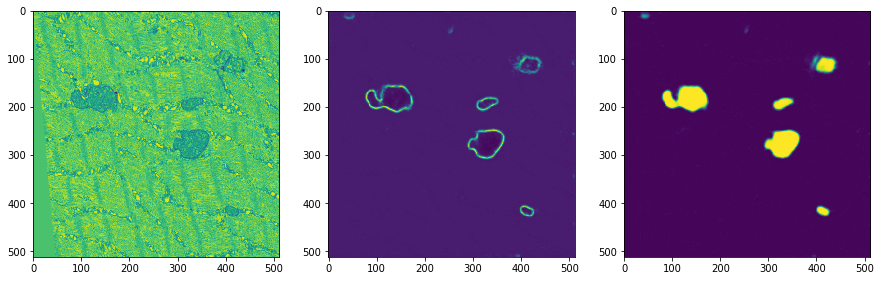

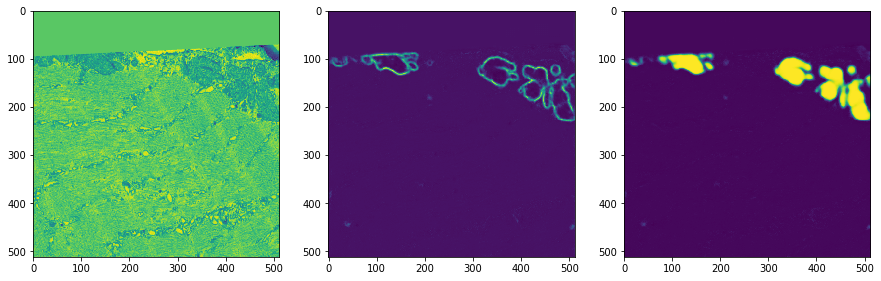

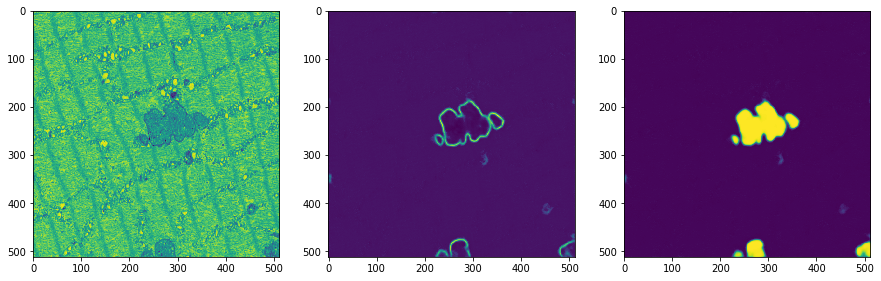

600
Training loss:  0.007433119
(3, 512, 512, 2)
Validation loss:  0.005175729


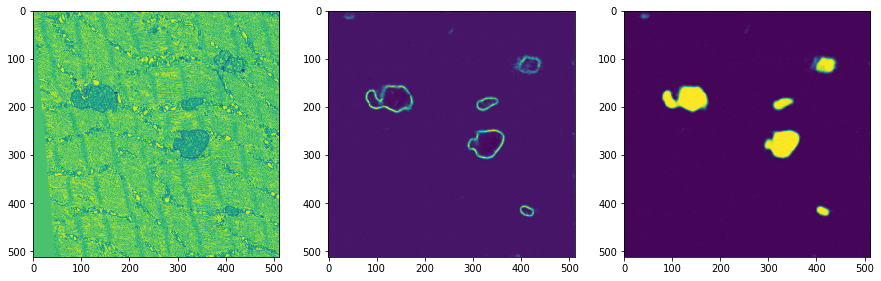

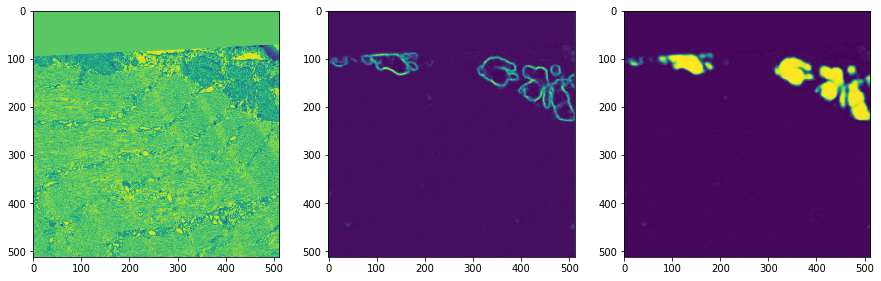

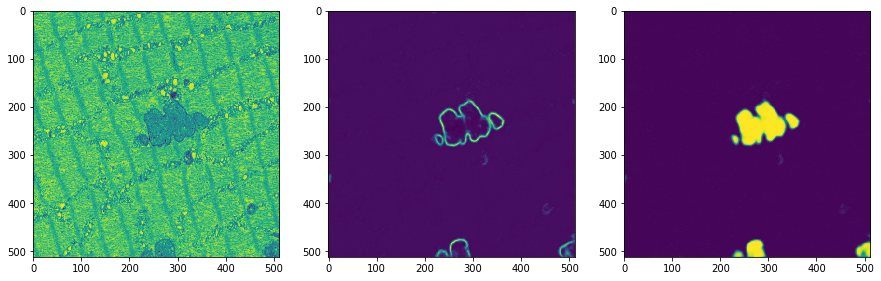

700
Training loss:  0.008370575
(3, 512, 512, 2)
Validation loss:  0.005141972


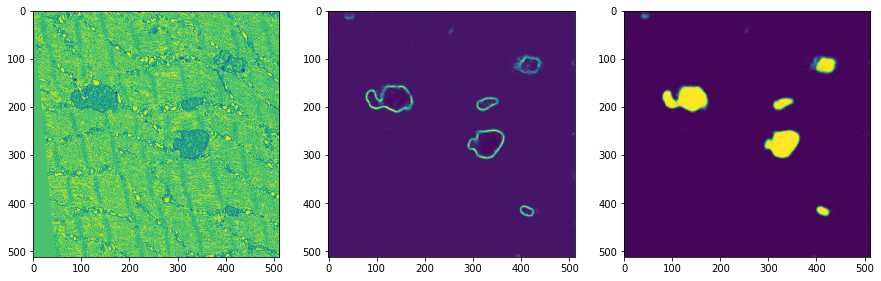

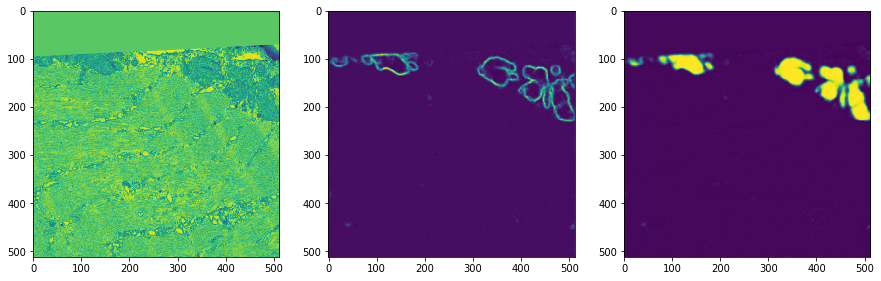

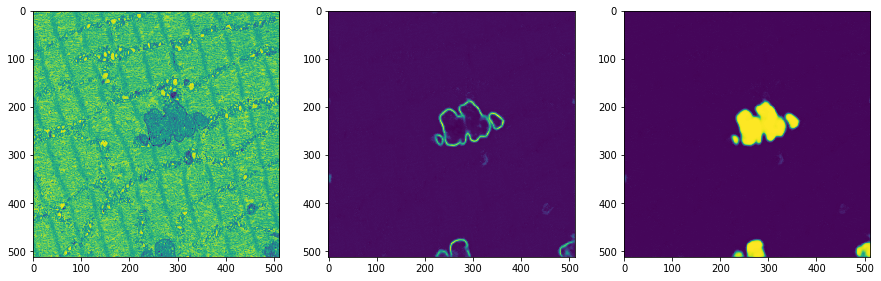

800
Training loss:  0.010153889
(3, 512, 512, 2)
Validation loss:  0.005244376


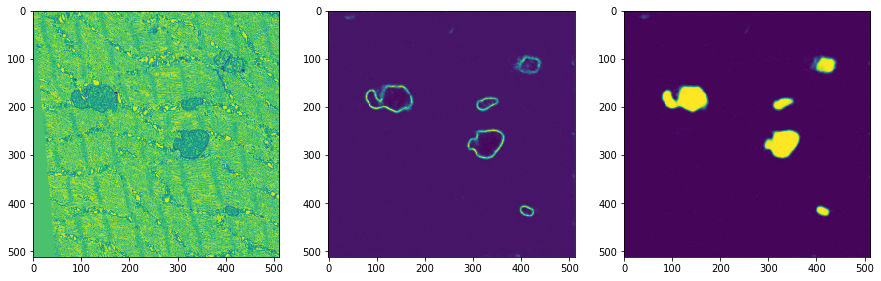

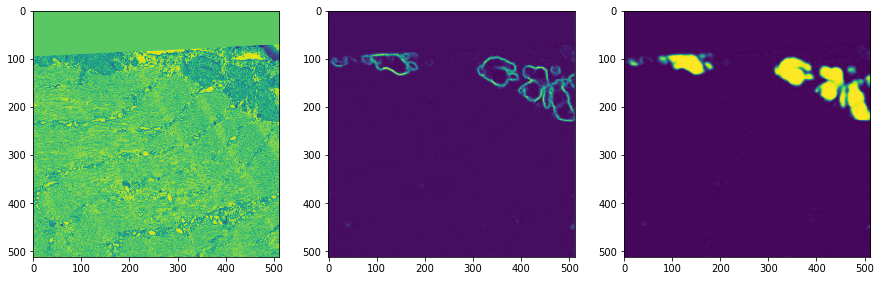

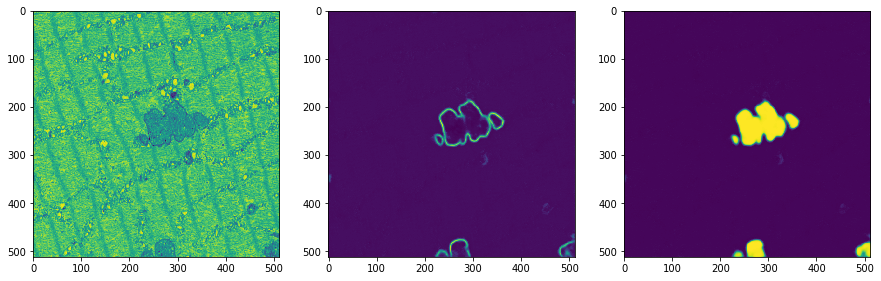

900
Training loss:  0.00825664
(3, 512, 512, 2)
Validation loss:  0.005039207


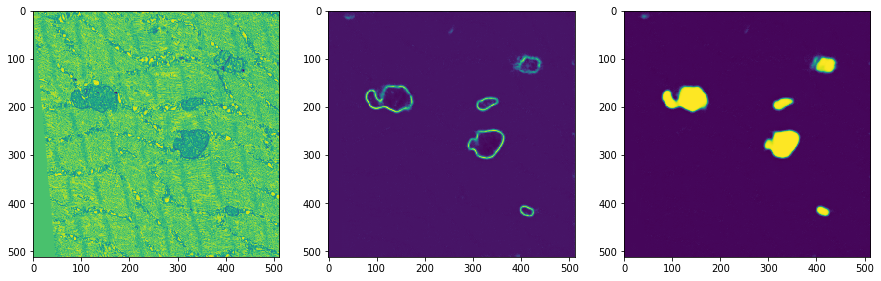

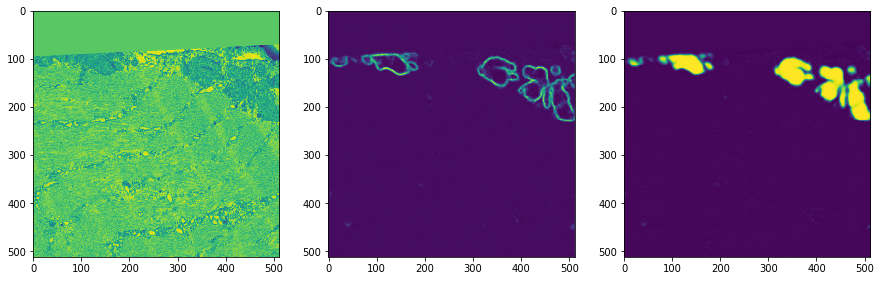

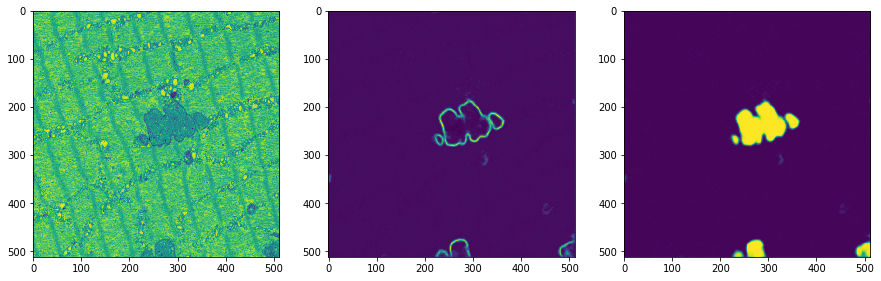

1000
Training loss:  0.009528242
(3, 512, 512, 2)
Validation loss:  0.0051275715


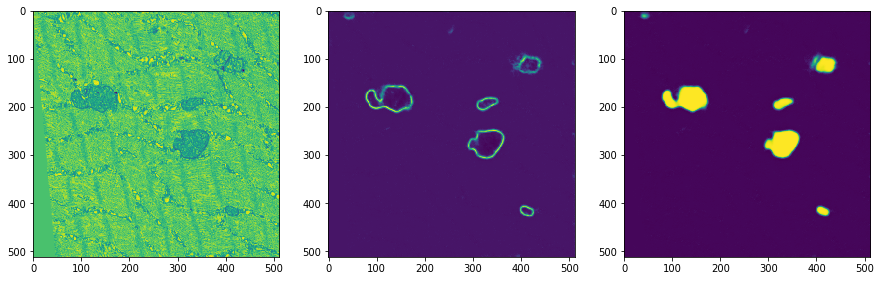

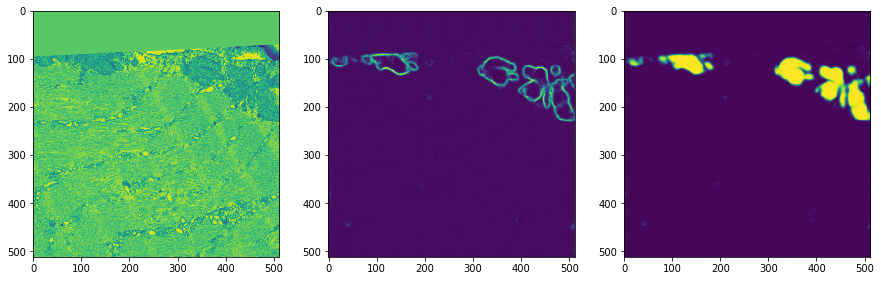

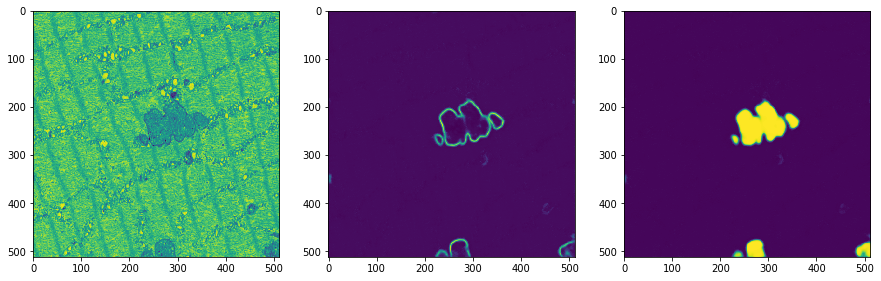

1100
Training loss:  0.0057472433
(3, 512, 512, 2)
Validation loss:  0.005115318


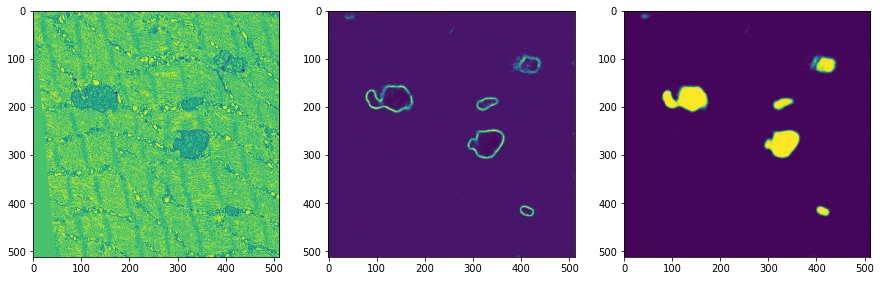

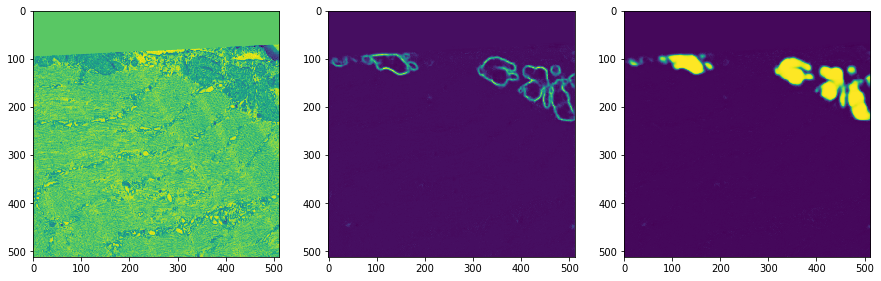

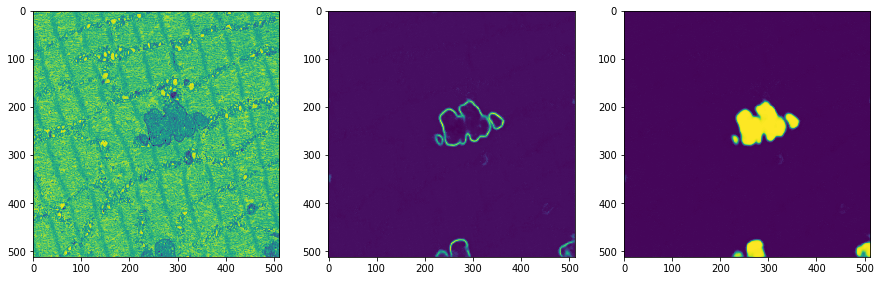

1200
Training loss:  0.0063980236
(3, 512, 512, 2)
Validation loss:  0.0049404763


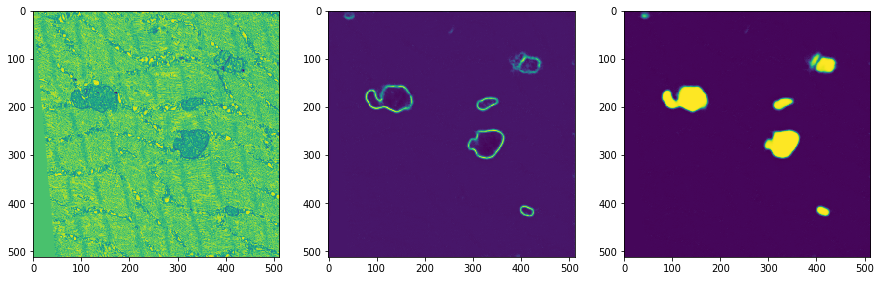

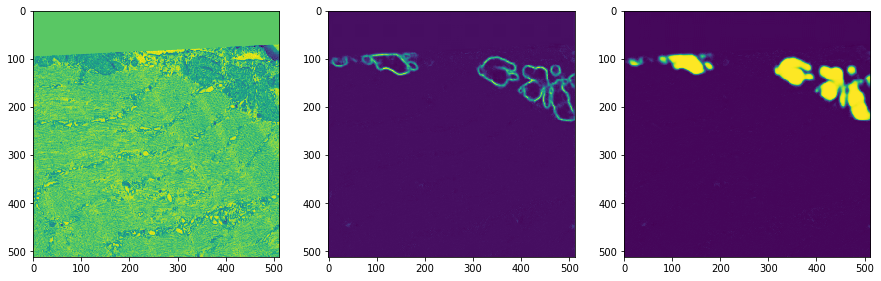

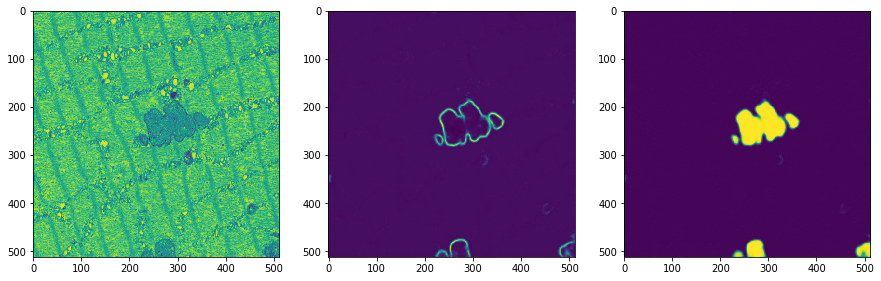

1300
Training loss:  0.009417358
(3, 512, 512, 2)
Validation loss:  0.0048163314


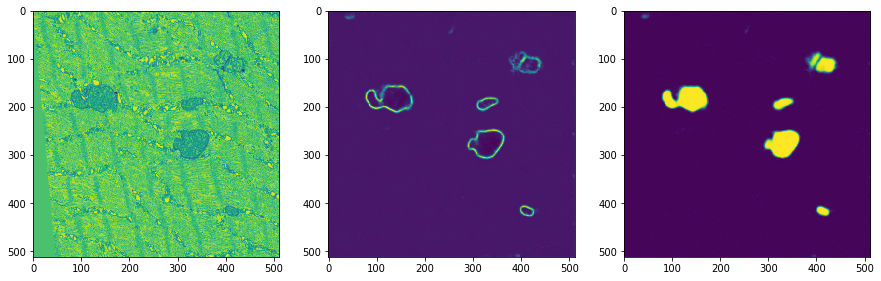

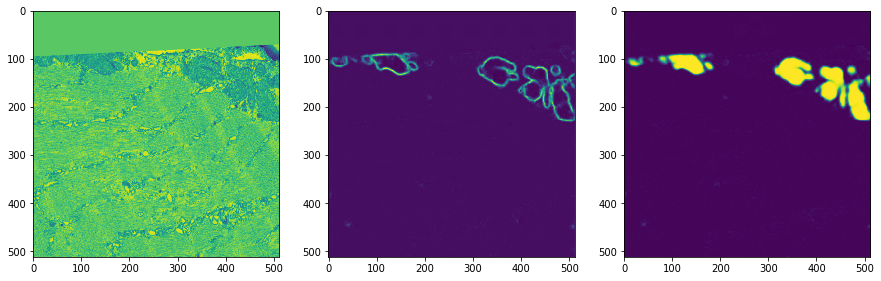

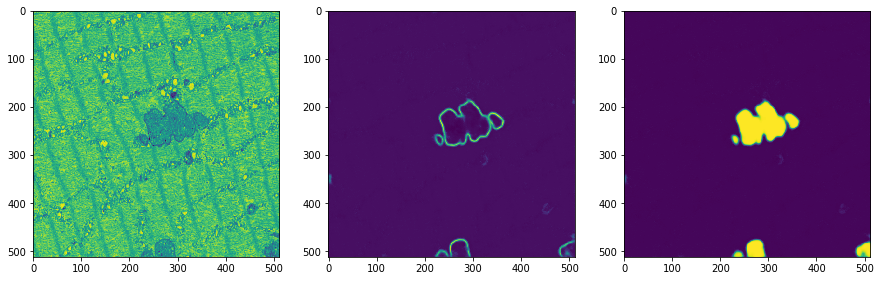

1400
Training loss:  0.008767967
(3, 512, 512, 2)
Validation loss:  0.004719852


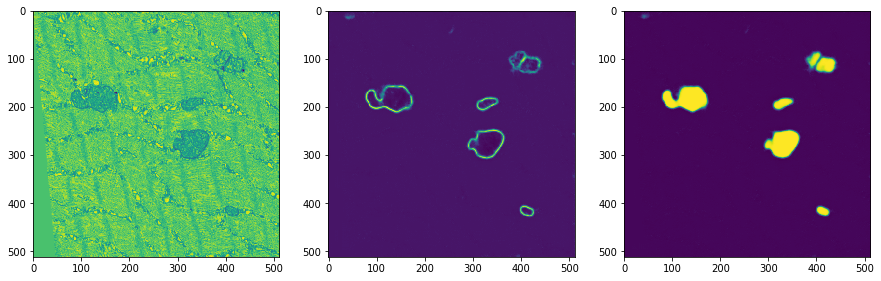

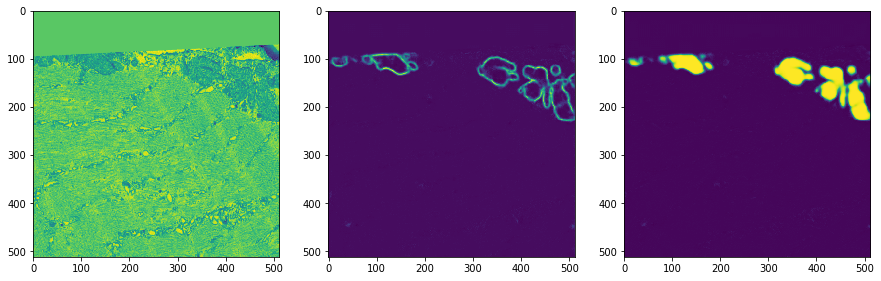

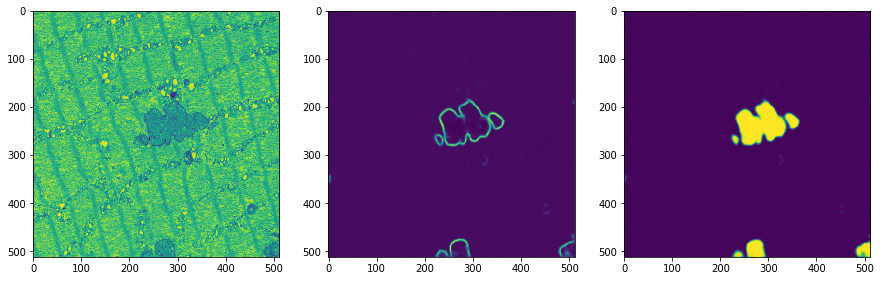

1500
Training loss:  0.008230918
(3, 512, 512, 2)
Validation loss:  0.004679288


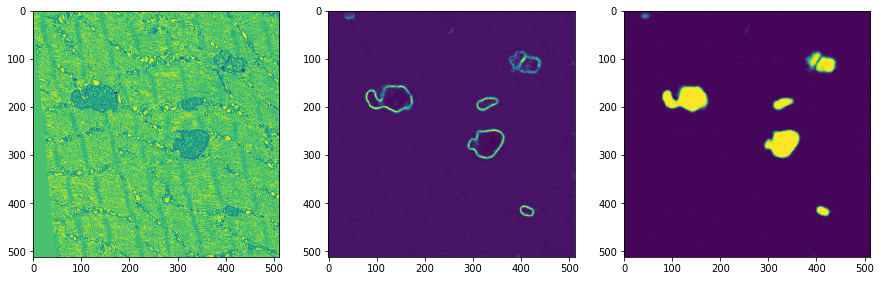

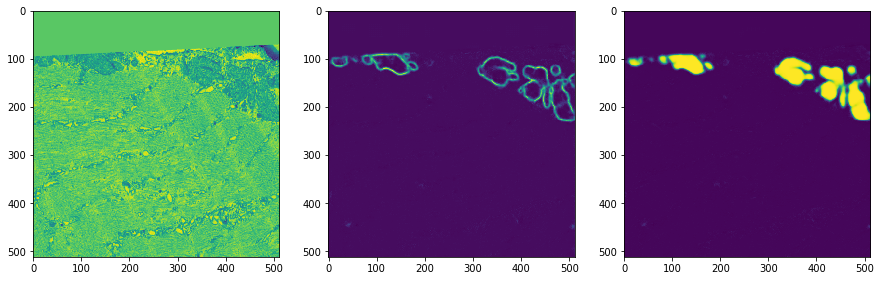

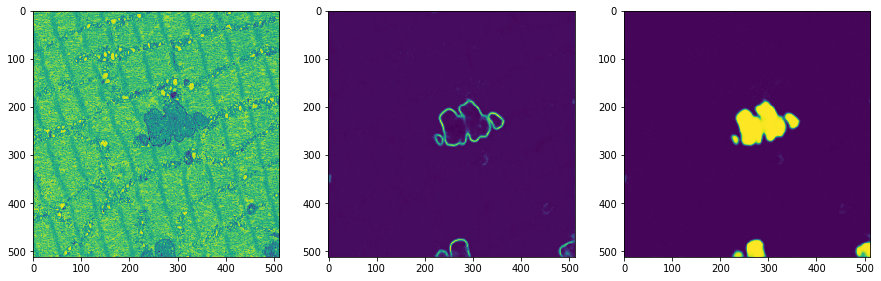

1600
Training loss:  0.007872763
(3, 512, 512, 2)
Validation loss:  0.0046318164


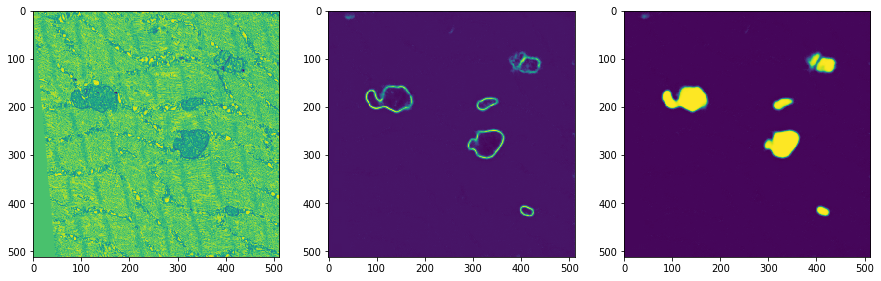

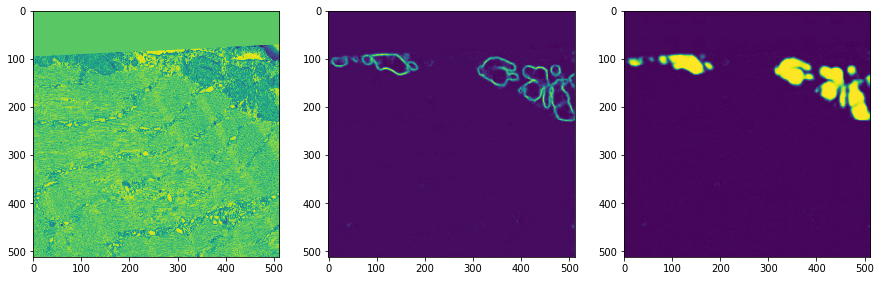

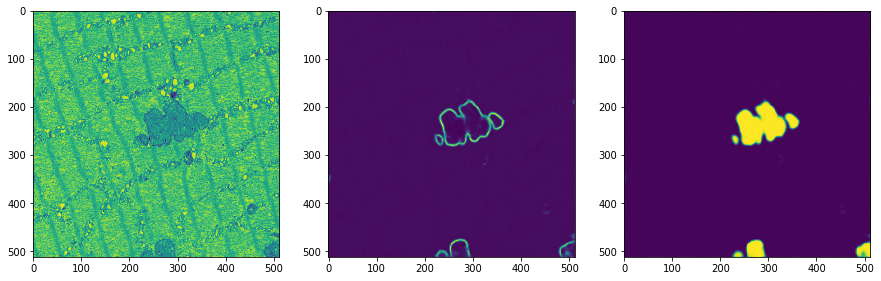

1700
Training loss:  0.007647643
(3, 512, 512, 2)
Validation loss:  0.0045695878


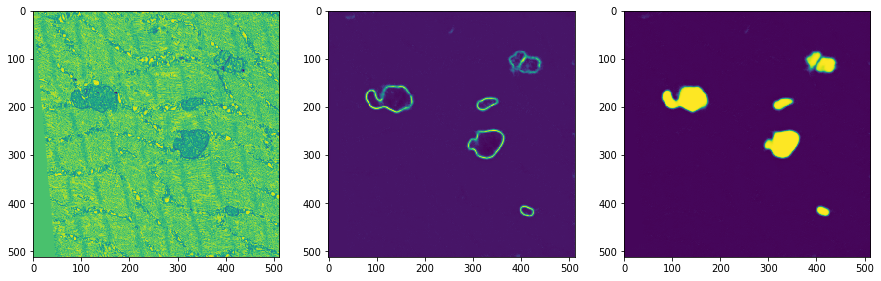

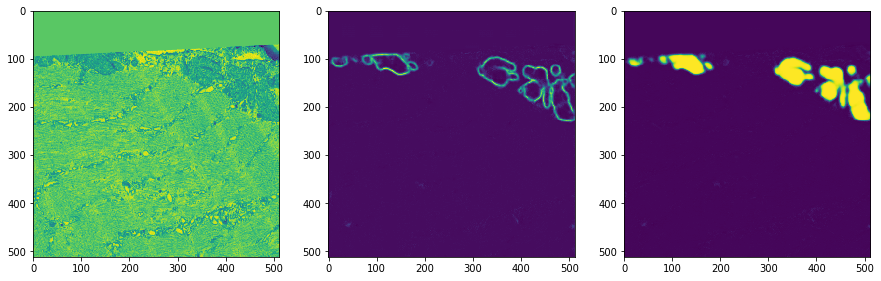

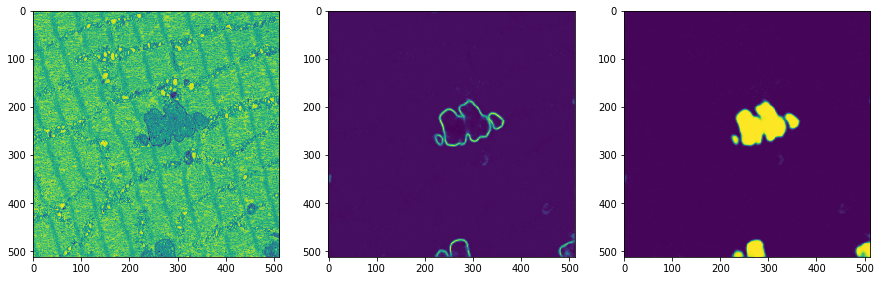

1800
Training loss:  0.005671088
(3, 512, 512, 2)
Validation loss:  0.0045387815


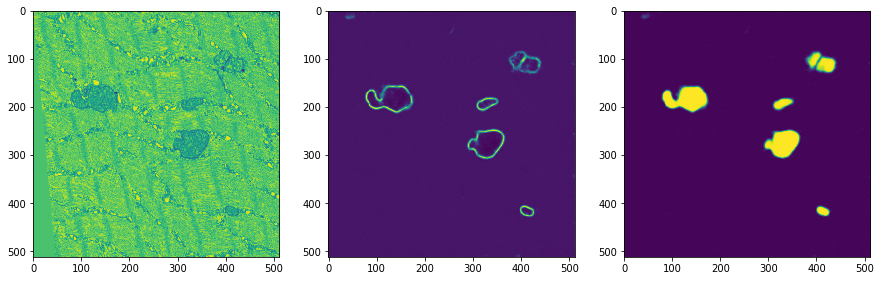

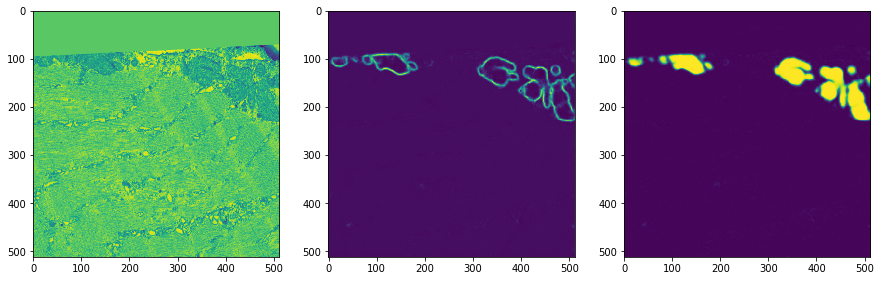

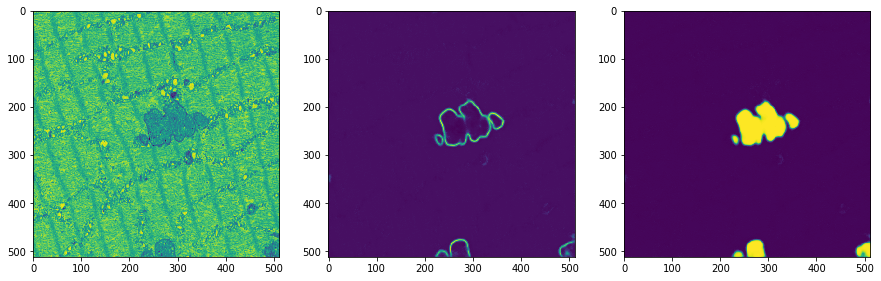

1900
Training loss:  0.0061997413
(3, 512, 512, 2)
Validation loss:  0.0044387146


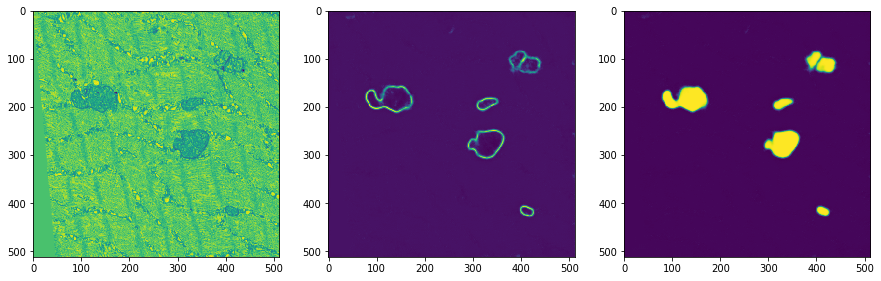

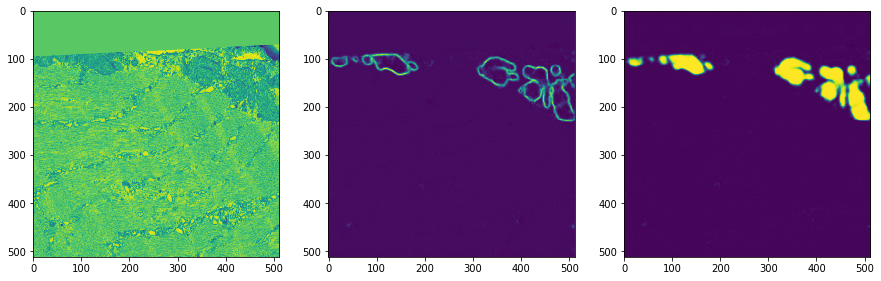

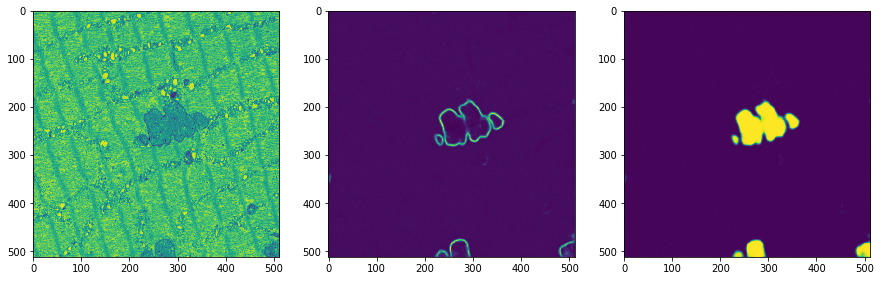

2000
Training loss:  0.005319134
(3, 512, 512, 2)
Validation loss:  0.004447524


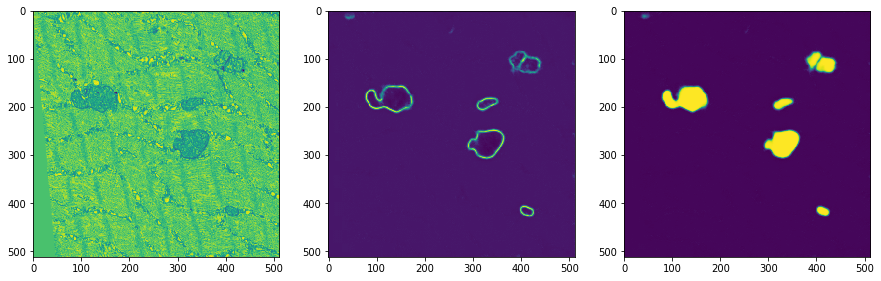

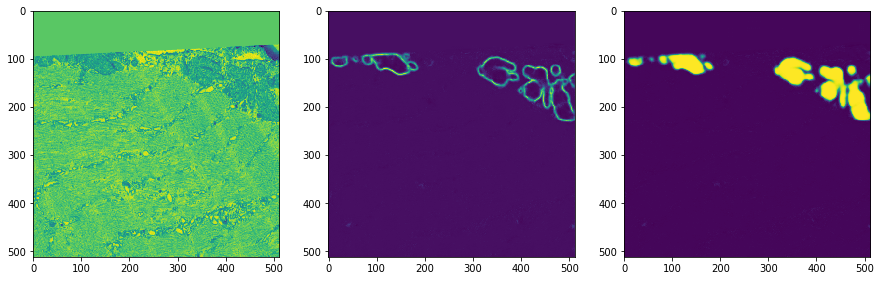

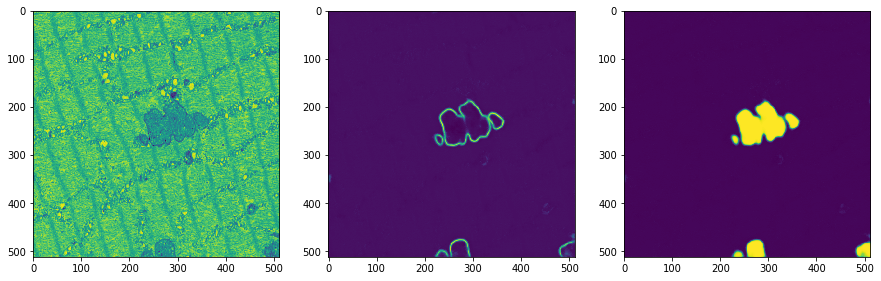

2100
Training loss:  0.0059513003
(3, 512, 512, 2)
Validation loss:  0.004334129


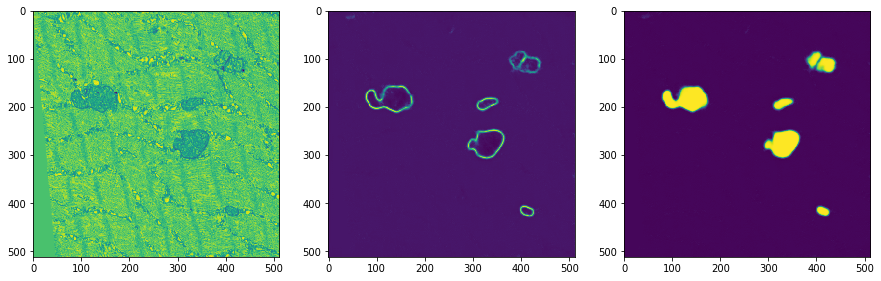

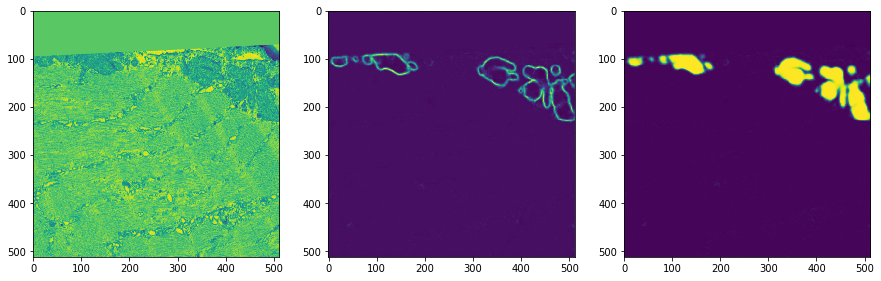

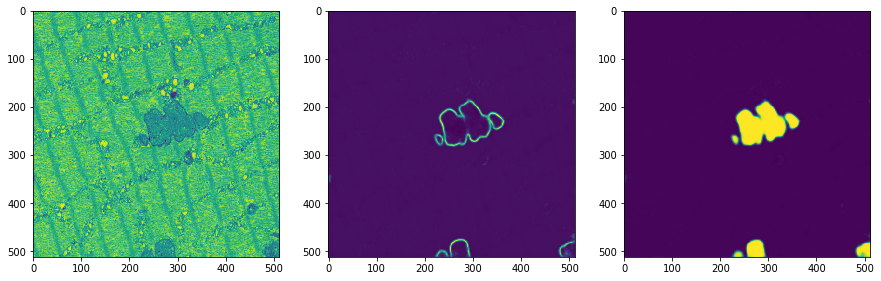

In [57]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
saver = tf.train.Saver(max_to_keep=50)
#train_writer = tf.summary.FileWriter('./logs/1/train ', sess.graph)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.00005, 0.00002, 0.00002, 0.00001]
learning_rate_steps=[500,1500, 2200, 2200]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[25])
        cur_train=train_data[idx,:,:,:]+np.random.uniform(-baseline_noise, baseline_noise, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses=sess.run([merge, probs, loss], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            if (losses<current_best[1]):
                current_best=[i, losses]
                file=open(data+'Network.txt', 'w')
                file.write(str(base_scaler)+'\n')
                file.write(str(baseline_noise)+'\n')
                file.write(str(x_dim)+'\n')
                file.write(str(mean)+'\n')
                file.write(str(std)+'\n')
                file.write(str(i)+'\n')
                file.write(str(channels)+'\n')
                file.close()
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,:,:,0], results[ti,:,:,0], results[ti,:,:,1])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs